<a href="https://colab.research.google.com/github/Gayatriik18/Style-Transfer-using-Generative-Adversarial-Network-GAN-/blob/main/Capstone_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Style Transfer of MRI Images**

## Problem statement:
To build a Generative adversarial model(modified U-Net) which can generate artificial MRI images of different contrast levels from existing MRI scans.

#### Background
Misdiagnosis in the medical field is a very serious issue but it’s also uncomfortably common to occur. Imaging procedures in the medical field requires an expert radiologist’s opinion since interpreting them is not a simple binary process ( Normal or Abnormal). Even so, one radiologist may see something that another does not. This can lead to conflicting reports and make it difficult to effectively recommend treatment options to the patient.

One of the complicated tasks in medical imaging is to diagnose MRI(Magnetic Resonance Imaging). Sometimes to interpret the scan, the radiologist needs different variations of the imaging which can drastically enhance the accuracy of diagnosis by providing practitioners with a more comprehensive understanding.

But to have access to different imaging is difficult and expensive. With the help of deep learning, we can use style transfer to generate artificial MRI images of different contrast levels from existing MRI scans. This will help to provide a better diagnosis with the help of an additional image.

In this project, CycleGAN has been used to translate the style of one MRI image to another, which will help in a better understanding of the scanned image. Using GANs, T2 weighted images are generated from T1 weighted MRI image and vice-versa.

****

## Pipeline

1. Data Preparation
2. Data Processing
3. Model Building
4. Model Training

In [ ]:
# Importing required libraries
import numpy as np
import tensorflow as tf

import matplotlib.pyplot as plt
import imageio
import cv2
import os
import glob
import pathlib

from tensorflow import keras
from tensorflow.keras import layers, Sequential
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow.keras.utils import plot_model
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization, Activation, Flatten, Conv2D, Conv2DTranspose
from keras.utils.vis_utils import plot_model

In [ ]:
#Google Colab set up - Use if using Google Colab
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
# Defining the path for the data
base_dir = pathlib.Path("/content/gdrive/My Drive/Colab Notebooks/Capstone/MRI")
os.chdir(base_dir)

data_dir_T1 = pathlib.Path(str(base_dir) + "/Tr1/TrainT1")
data_dir_T2 = pathlib.Path(str(base_dir) + "/Tr2/TrainT2")

print("Path for T1 data :\n", data_dir_T1)
print("Path for T2 data :\n", data_dir_T2)

Path for T1 data :
 /content/gdrive/My Drive/Colab Notebooks/Capstone/MRI/Tr1/TrainT1
Path for T2 data :
 /content/gdrive/My Drive/Colab Notebooks/Capstone/MRI/Tr2/TrainT2


## Data Preparing

### Basic EDA

In [ ]:
# Reading an image to check dimension
sample = cv2.imread(str(data_dir_T1)+"/Image #10.png")
sample.shape

(217, 181, 3)

In [ ]:
img_count_T1 = len(list(data_dir_T1.glob('*.png')))
print("No. of images in T1 dataset: ", img_count_T1)
img_count_T2 = len(list(data_dir_T2.glob('*.png')))
print("No. of images in T2 dataset: ", img_count_T2)

No. of images in T1 dataset:  43
No. of images in T2 dataset:  46


In [ ]:
# Setting input image sizes
img_height = 215
img_width = 180

In [ ]:
# Setting default batch size
batch_size = 64

### Data Loading

In [ ]:
# Loading T1 images
images_T1 = image_dataset_from_directory(data_dir_T1, seed = 123, shuffle = True, labels = None,
                                         image_size=(img_height, img_width), batch_size=batch_size)

Found 43 files belonging to 1 classes.


In [ ]:
# loading T2 images
images_T2 = image_dataset_from_directory(data_dir_T2, seed = 123, shuffle = True, labels = None,
                                         image_size=(img_height, img_width), batch_size=batch_size)

Found 46 files belonging to 1 classes.


### Data Visualization

T1 data examples


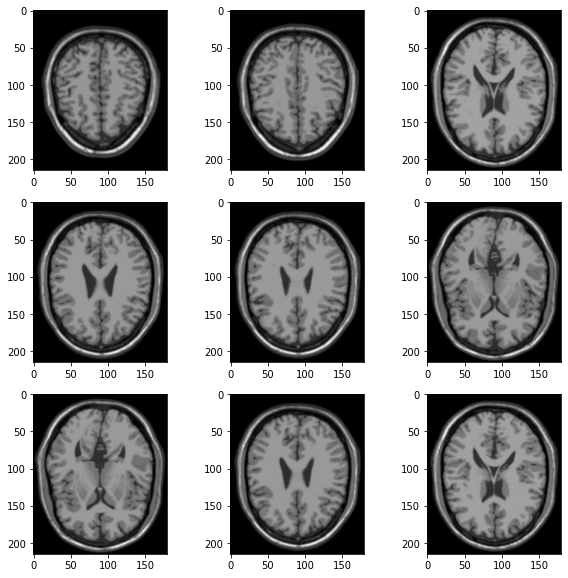

In [ ]:
# Visualizing data from T1 dataset
plt.figure(figsize=(10, 10))
for images in images_T1.take(1):
  print("T1 data examples")
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))

T2 data examples



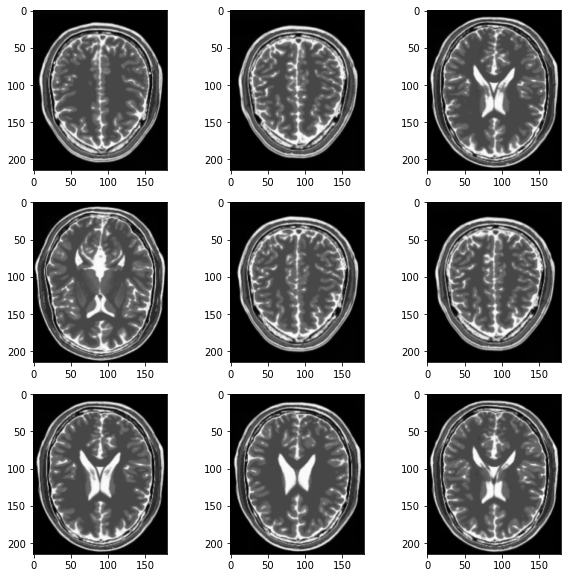

In [ ]:
# Visualizing data from T2 dataset
plt.figure(figsize=(10, 10))
for images in images_T2.take(1):
  print("T2 data examples\n")
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))

In [ ]:
# Range of values of the pixels making up the image in T1 data
image_batch = next(iter(images_T1))
first_image = image_batch[0]
print("T1 data pixel value range: ", np.min(first_image), np.max(first_image))

T1 data pixel value range:  0.0 252.99551


In [ ]:
# Checking range of values of the pixels making up the image in T2 data
image_batch = next(iter(images_T2))
first_image = image_batch[0]
print("T2 data pixel value range: ", np.min(first_image), np.max(first_image))

T2 data pixel value range:  0.0 251.65068


## Data Processing
1. Data Normalization
2. Data Resizing
3. Data Reshaping
4. Batch and Shuffle Data

### Data Normalization

In [ ]:
# Define normalization function - Normalizing data in the range [-1.0, 1.0]
normalization_layer = layers.experimental.preprocessing.Rescaling(scale = 1./127.5, offset =-1.0)

In [ ]:
# Normalizing T1 data
images_T1_norm = images_T1.map(lambda x: (normalization_layer(x)))
image_batch1 = next(iter(images_T1_norm))
first_image = image_batch1[0]
print("Minimum and maximum pixel values after normalization")
print(np.min(first_image), np.max(first_image))

Minimum and maximum pixel values after normalization
-1.0 0.9645183


In [ ]:
images_T1_batch  = next(iter(images_T1_norm))
images_T1_batch.shape

TensorShape([43, 215, 180, 3])

T1 data examples after normalization


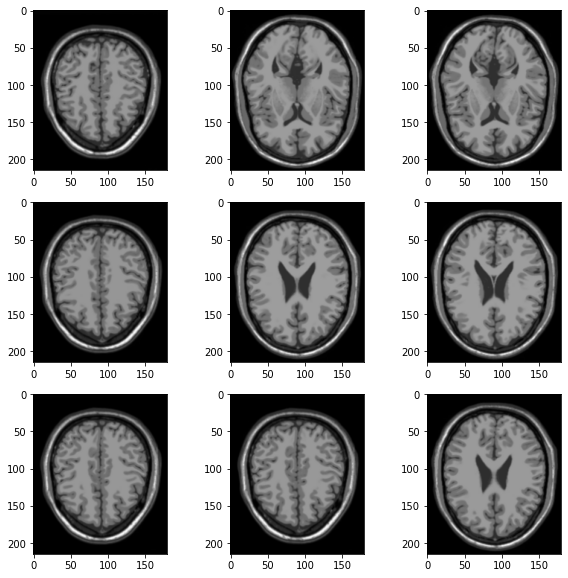

In [ ]:
# Visualizing data from T1 dataset after normalization
plt.figure(figsize=(10, 10))
for images in images_T1_norm.take(1):
  print("T1 data examples after normalization")
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow((images[i] * 127.5 + 127.5).numpy().astype("uint8"))   # Reversing the scaling for visualization

In [ ]:
# Normalizing T2 data
images_T2_norm = images_T2.map(lambda x: (normalization_layer(x)))
image_batch2 = next(iter(images_T2_norm))
first_image = image_batch2[0]
print("Minimum and maximum pixel values after normalization")
print(np.min(first_image), np.max(first_image))

Minimum and maximum pixel values after normalization
-1.0 0.9737767


In [ ]:
images_T2_batch  = next(iter(images_T2_norm))
images_T2_batch.shape

TensorShape([46, 215, 180, 3])

T2 data examples after normalization


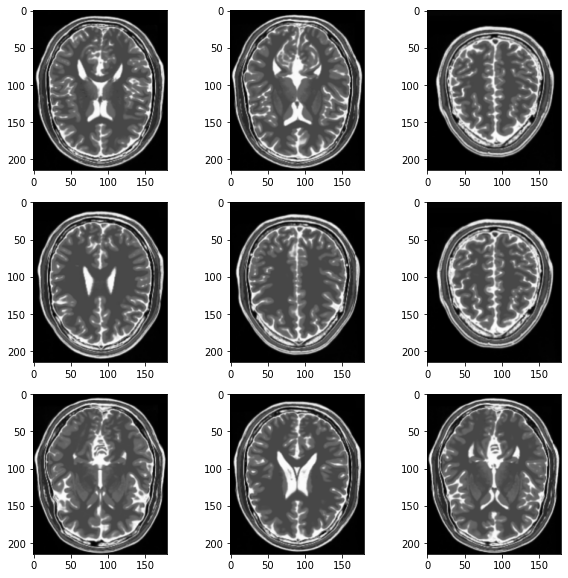

In [ ]:
# Visualizing data from T2 dataset after normalization
plt.figure(figsize=(10, 10))
for images in images_T2_norm.take(1):
  print("T2 data examples after normalization")
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow((images[i] * 127.5 + 127.5).numpy().astype("uint8"))   # Reversing the scaling for visualization

### Data Resizing to (128,128)

- Resizing to a dimensions with a power of 2 allows optimal usage of memory.

In [ ]:
# Define resizing function
resize_layer = layers.experimental.preprocessing.Resizing(128, 128, interpolation='bilinear')

Shape of resized images:  (128, 128, 3) 



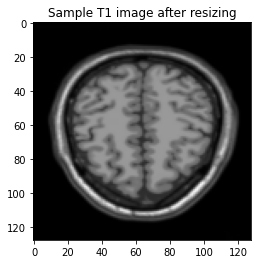

In [ ]:
# Resizing T1 data
images_T1_resized = images_T1_norm.map(lambda x: (resize_layer(x)))

# Obtaining a batch of T1 data.
image_batch = next(iter(images_T1_resized))
first_image = image_batch[0]
print("Shape of resized images: ",first_image.shape,"\n")

# Plotting the first image in the batch of T1 data.
plt.imshow((first_image * 127.5 + 127.5).numpy().astype("uint8"))   # Reversing the scaling for visualization
plt.title("Sample T1 image after resizing")
plt.show()

Shape of resized images:  (128, 128, 3) 



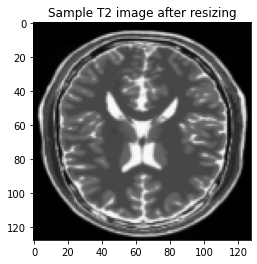

In [ ]:
# Resizing T2 data
images_T2_resized = images_T2_norm.map(lambda x: (resize_layer(x)))

# Obtaining a batch of T2 data.
image_batch = next(iter(images_T2_resized))
first_image = image_batch[0]
print("Shape of resized images: ",first_image.shape,"\n")

# Plotting the first image in the batch of T2 data.
plt.imshow((first_image * 127.5 + 127.5).numpy().astype("uint8"))   # Reversing the scaling for visualization
plt.title("Sample T2 image after resizing")
plt.show()

### Reshaping the data to a single channel

Since the MRI images are grayscale in nature, a single channel of data is sufficient to extract all the information we need.

In [ ]:
reshape_layer = layers.Reshape((128,128,1))

(43, 128, 128, 1)
Shape of reshaped images:  (128, 128, 1) 



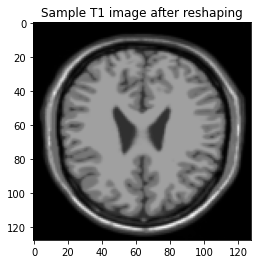

In [ ]:
images_T1_reshaped = images_T1_resized.map(lambda x : reshape_layer(x[:,:,:,0]))

image_batch = next(iter(images_T1_reshaped))
print(image_batch.shape)
first_image = image_batch[0]
print("Shape of reshaped images: ",first_image.shape,"\n")

# Plotting the first image in the batch of T1 data.
plt.imshow(first_image.numpy()[:, :, 0], cmap='gray')
plt.title("Sample T1 image after reshaping")
plt.show()

(46, 128, 128, 1)
Shape of reshaped images:  (128, 128, 1) 



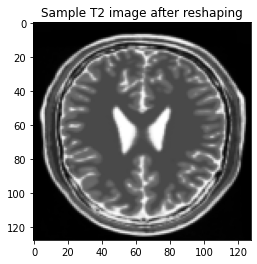

In [ ]:
images_T2_reshaped = images_T2_resized.map(lambda x : reshape_layer(x[:,:,:,0]))

image_batch = next(iter(images_T2_reshaped))
print(image_batch.shape)
first_image = image_batch[0]
print("Shape of reshaped images: ",first_image.shape,"\n")

# Plotting the first image in the batch of T1 data.
plt.imshow(first_image.numpy()[:, :, 0], cmap='gray')
plt.title("Sample T2 image after reshaping")
plt.show()

### Batch and reshuffling data

- Shuffling the data is one of the thing to remove any continuity bias
- The data already exists as a batch since the number of images is relatively small so we consider the entire dataset for each type as a batch for that type.

In [ ]:
# buffer size higher than the number of data samples allows effective shuffling
BUFFER_SIZE = 64

In [ ]:
# Shuffling the data
T1_data = images_T1_reshaped.shuffle(BUFFER_SIZE)
T2_data = images_T2_reshaped.shuffle(BUFFER_SIZE)

Shape of T1 image batch:  (43, 128, 128, 1)
Shape of individual images:  (128, 128, 1) 



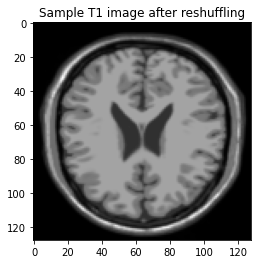

In [ ]:
# Obtaining a batch of T1 data.
image_batch = next(iter(T1_data))
print("Shape of T1 image batch: ", image_batch.shape)
first_image = image_batch[0]
print("Shape of individual images: ",first_image.shape,"\n")

# Plotting the first image in the batch of T1 data.
plt.imshow(first_image.numpy()[:, :, 0], cmap='gray')
plt.title("Sample T1 image after reshuffling")
plt.show()

Shape of T2 image batch:  (46, 128, 128, 1)
Shape of individual images:  (128, 128, 1) 



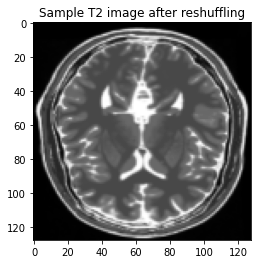

In [ ]:
# Obtaining a batch of T2 data.
image_batch = next(iter(T2_data))
print("Shape of T2 image batch: ", image_batch.shape)
first_image = image_batch[0]
print("Shape of individual images: ",first_image.shape,"\n")

# Plotting the first image in the batch of T2 data.
plt.imshow(first_image.numpy()[:, :, 0], cmap='gray')
plt.title("Sample T2 image after reshuffling")
plt.show()

## Model Building
1. Instance Normalization
2. Downsampling, Upsampling and Unet
3. Generator Building using Unet
4. Discriminator Building

### Instance Normalization

Instance Normalization are specially used with Style Transfer, as for each sample we perform channelwise Normalization.


In [ ]:
class InstanceNormalization(tf.keras.layers.Layer):
    # Initialization of Objects
    def __init__(self, epsilon=1e-5):
        # calling parent's init
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon

    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)

    def call(self, x):
        # Compute Mean and Variance, Axes=[1,2] ensures Instance Normalization
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

### Downsampling
- It uses Conv2D layers
- It reduces the dimension with each new layer adding to it

In [ ]:
def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Adding Conv2d layer
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    # Adding Normalization layer
    if apply_norm:
        result.add(InstanceNormalization())
    # Adding Leaky Relu Activation
    result.add(tf.keras.layers.LeakyReLU())
    return result

### Upsampling

- It uses Transposed Convolution layers
- It increases the dimensions of the layers

In [ ]:
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Adding Transposed Conv2d layer
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    # Adding Normalization Layer
    result.add(InstanceNormalization())
    # Conditionally adding Dropout layer
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    # Adding Relu Activation Layer
    result.add(tf.keras.layers.ReLU())
    return result

## Unet Generator is a combination of Convolution + Transposed Convolution Layers

In [ ]:
def unet_generator():
    down_stack = [
        downsample(64, 4, True), # (bs, 64, 64, 64)
        downsample(64, 4),        # (bs, 32, 32, 64)
        downsample(128, 4),       # (bs, 16, 16, 128)
        downsample(128, 4),       # (bs, 8, 8, 128)
        downsample(256, 4),       # (bs, 4, 4, 256)
        downsample(256, 4),       # (bs, 2, 2, 256)
        downsample(512, 4)        # Bottleneck layer (bs, 1, 1, 512)
    ]
    up_stack = [
        upsample(256, 4, True),   # (bs, 2, 2, 256)
        upsample(256, 4),         # (bs, 4, 4, 256)
        upsample(128, 4),         # (bs, 8, 8, 128)
        upsample(128, 4),         # (bs, 16, 16,128)
        upsample(64, 4),          # (bs, 32, 32, 64)
        upsample(64, 4)           # (bs, 64, 64, 64)
    ]
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same', kernel_initializer=initializer,
                                           activation='tanh') # (bs, 128, 128, 1)

    # Apply skip connections
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[128, 128, 1])
    x = inputs

    # Downsampling through the model
    skips = []                # List to store downsampling layers' latent information
    for down in down_stack:
        x = down(x)
        skips.append(x)

    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])       # Concat skip connections with Up-sampling layers
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

### Generators
Generator is a Unet Network since we want to translate T1 images to T2 and vice-versa.

In [ ]:
# Defining generator models - The generator models for both the image types have identical structures.
generator_T1 = unet_generator()   # For generating T1 images
generator_T2 = unet_generator()   # For generating T2 images

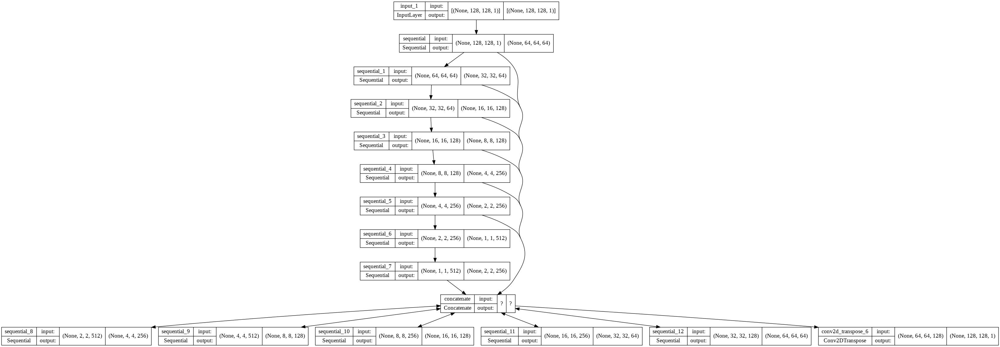

In [ ]:
# Visualizing generator model architecture
plot_model(generator_T1, show_shapes=True, show_layer_names=True)

In [ ]:
generator_T2.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 128, 128, 1  0           []                               
                                )]                                                                
                                                                                                  
 sequential_13 (Sequential)     (None, 64, 64, 64)   1152        ['input_2[0][0]']                
                                                                                                  
 sequential_14 (Sequential)     (None, 32, 32, 64)   65664       ['sequential_13[0][0]']          
                                                                                                  
 sequential_15 (Sequential)     (None, 16, 16, 128)  131328      ['sequential_14[0][0]']    

### Discriminators only contain Convolutional layers with no Transposed Convolution  used

Both Discriminators have same architecture.

In [ ]:
def discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    # add input layer of size (128, 128, 1)
    inp = tf.keras.layers.Input(shape=[128, 128, 1], name='input_image')
    x = inp

    # add downsampling step here
    down1 = downsample(64, 4, False)(x)                 # (bs, 64, 64, 64)
    down2_intermediate = downsample(128, 4)(down1)      # (bs, 32, 32, 128)
    down3_intermediate = downsample(256, 4)(down2_intermediate) # (bs, 16, 16, 256)
    down4 = downsample(512, 4)(down3_intermediate)      # (bs, 8, 8, 512)

    # Adding a zero-padding layer
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down4)  # (bs, 10, 10, 512)

    # implement a concrete downsampling layer here
    conv = tf.keras.layers.Conv2D(256, 4, strides=1, kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1)  # (bs, 7, 7, 256)
    norm1 = InstanceNormalization()(conv)                     # (bs, 7, 7, 256)
    leaky_relu = tf.keras.layers.LeakyReLU()(norm1)           # (bs, 7, 7, 256)

    # Adding another zero padding layer
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)   # (bs, 9, 9, 256)

    # add a last pure 2D Convolution layer
    last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2)   # (bs, 6, 6, 1 )

    return tf.keras.Model(inputs=inp, outputs=last)

In [ ]:
# Defining discriminators
discriminator_T1 = discriminator()
discriminator_T2 = discriminator()

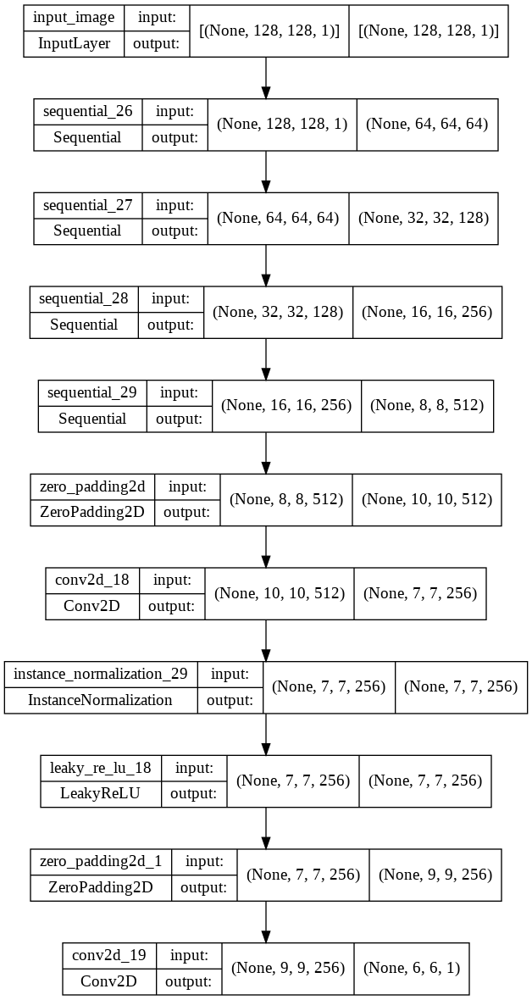

In [ ]:
# Visualizing discriminator model architecture
plot_model(discriminator_T1, show_shapes=True, show_layer_names=True)

In [ ]:
discriminator_T2.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_image (InputLayer)    [(None, 128, 128, 1)]     0         
                                                                 
 sequential_30 (Sequential)  (None, 64, 64, 64)        1024      
                                                                 
 sequential_31 (Sequential)  (None, 32, 32, 128)       131328    
                                                                 
 sequential_32 (Sequential)  (None, 16, 16, 256)       524800    
                                                                 
 sequential_33 (Sequential)  (None, 8, 8, 512)         2098176   
                                                                 
 zero_padding2d_2 (ZeroPaddi  (None, 10, 10, 512)      0         
 ng2D)                                                           
                                                           

## Model Training
1. Declaring Loss type
2. Calculating Discriminator Loss
3. Calculating Generator Loss
4. Cycle Loss
5. Identity Loss
6. Optimizer
7. Checkpoint Initialization
8. Training Flow

### Checking output of untrained generator

In [ ]:
sample_T1_data = next(iter(T1_data))
sample_T2_data = next(iter(T2_data))

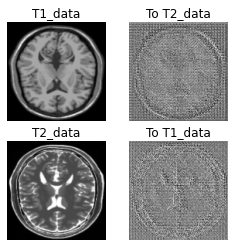

In [ ]:
to_T2_data = generator_T2(sample_T1_data)   # Generating T2 from T1 data
to_T1_data = generator_T1(sample_T2_data)   # Generating T1 from T2 data

plt.figure(figsize=(4, 4))

imgs = [sample_T1_data, to_T2_data, sample_T2_data, to_T1_data]
title = ['T1_data', 'To T2_data', 'T2_data', 'To T1_data']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    plt.imshow(imgs[i][0].numpy()[:, :, 0], cmap='gray')
    plt.axis('off')
plt.show()

### Declare Loss  is as Binary Cross Entropy, since Discriminator is a classifier

In [ ]:
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

### Discriminator Loss
Consists of two types of losses
1.    Loss on Real Data
2.    Loss on Fake Data

In [ ]:
def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real)
    generated_loss = loss_obj(tf.zeros_like(generated), generated)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss * 0.5      # mean of losses

### Generator Loss
It has only one type of loss - Discriminator Loss on Generated data

In [ ]:
def generator_loss(generated):
    return loss_obj(tf.ones_like(generated), generated)

### Cycle Loss
When we use both of Generators sequentially on a Input Image, we get Cycle Image and the L1 Loss between these two is called Cycle Loss.

In [ ]:
def calc_cycle_loss(real_image, cycled_image):
    cycle_loss = tf.reduce_mean(tf.abs(real_image - cycled_image))  # Averages out all values in the input
    return 10.0 * cycle_loss                                        # Weight of 10 used as contribution of cycle loss to total loss. This is a hyperparameter.

### Identity Loss
When we provide input image to the Generator such that no translation is needed because the image is already transformed, the difference should be minimal between original and generated image. Here also we take L1 Loss between input and output image.



In [ ]:
def identity_loss(real_image, same_image):
    id_loss = tf.reduce_mean(tf.abs(real_image - same_image))       # Averages out all values in the input
    return 2.0 * id_loss                                            # Weight of 2.0 used as contribution of identity loss to total loss. This is a hyperparameter.

### Optimizer definition.


In [ ]:
generator_T1_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_T2_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_T1_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_T2_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

### Checkpoint Initialization
Initializing checkpoints to save models

In [ ]:
# Directory to keep Checkpoints at each epoch
if not os.path.isdir('training_checkpoints'):
    os.mkdir('training_checkpoints')

checkpoint_path = "./training_checkpoints"

ckpt = tf.train.Checkpoint(generator_T1=generator_T1,
                           generator_T2=generator_T2,
                           discriminator_T1=discriminator_T1,
                           discriminator_T2=discriminator_T2,
                           generator_T1_optimizer=generator_T1_optimizer,
                           generator_T2_optimizer=generator_T2_optimizer,
                           discriminator_T1_optimizer=discriminator_T1_optimizer,
                           discriminator_T2_optimizer=discriminator_T2_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=3)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!!')

In [ ]:
# Directory to keep Generated Images each epoch
if not os.path.isdir('generated_images'):
    os.mkdir('generated_images')

# Function to show Images output by Generators while Training
def generate_images(model1, test_input1, model2, test_input2, epoch):
    prediction1 = model1(test_input1)
    prediction2 = model2(test_input2)
    plt.figure(figsize=(4, 4))
    display_list = [test_input1[0], prediction1[0], test_input2[0], prediction2[0]]
    title = ['Input T1', 'Predicted T2 - Epoch ' + str(epoch), 'Input T2', 'Predicted T1 - Epoch ' + str(epoch)]
    for i in range(4):
        plt.subplot(2, 2, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i].numpy()[:, :, 0], cmap='gray')
        plt.axis('off')

    plt.savefig('./generated_images/image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

### Training Flow
The function below performs one flow of batch training

Sequence of Training Flow

1.   Generating Fake T2 and Cycled T1
2.   Generating Fake T1 and Cycled T2
3.   Generating Fake Images through T1 and T2 for Identity Loss.
4.   Calculating Discriminator Loss for Disc T1 and Disc T2 on Fake Data for Generator Training.
5.   Calculating Generator Loss on Discriminator.
6.   Calculating Cycled Loss on Cycled Images from step 1 and 2.
7.   Calculating Total Generator Loss - Disc Loss + Cycled Loss + Identity Loss
8.   Calculating Discriminator Loss on both Fake and Real Images for Disc X and Y for Disc Training.
9.   Calculating the Gradients and update the weight and bias of models.

In [ ]:
@tf.function
def train_step(real_T1, real_T2):
    # persistent is set to True because the tape is used more than once to calculate the gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator T2 translates T1 -> T2
        # Generator T1 translates T2 -> T1
        fake_T2 = generator_T2(real_T1, training=True)
        cycled_T1 = generator_T1(fake_T2, training=True)

        fake_T1 = generator_T1(real_T2, training=True)
        cycled_T2 = generator_T2(fake_T1, training=True)

        # same_x and same_y are used for identity loss.
        same_T1 = generator_T1(real_T1, training=True)
        same_T2 = generator_T2(real_T2, training=True)

        disc_real_T1 = discriminator_T1(real_T1, training=True)
        disc_real_T2 = discriminator_T2(real_T2, training=True)

        disc_fake_T1 = discriminator_T1(fake_T1, training=True)
        disc_fake_T2 = discriminator_T2(fake_T2, training=True)

        # calculate generator loss
        gen_T2_loss = generator_loss(disc_fake_T2)
        gen_T1_loss = generator_loss(disc_fake_T1)

        # Calculate cycle loss
        total_cycle_loss = calc_cycle_loss(real_T1, cycled_T1) + calc_cycle_loss(real_T2, cycled_T2)

        # Total generator loss = BCE loss + cycle loss + identity loss
        total_gen_T1_loss = gen_T1_loss + total_cycle_loss + identity_loss(real_T1, same_T1)
        total_gen_T2_loss = gen_T2_loss + total_cycle_loss + identity_loss(real_T2, same_T2)

        # Discriminator's loss
        disc_T1_loss = discriminator_loss(disc_real_T1, disc_fake_T1)
        disc_T2_loss = discriminator_loss(disc_real_T2, disc_fake_T2)

    # Calculate the gradients for generator and discriminator
    generator_T1_gradients = tape.gradient(total_gen_T1_loss, generator_T1.trainable_variables)
    generator_T2_gradients = tape.gradient(total_gen_T2_loss, generator_T2.trainable_variables)

    discriminator_T1_gradients = tape.gradient(disc_T1_loss, discriminator_T1.trainable_variables)
    discriminator_T2_gradients = tape.gradient(disc_T2_loss, discriminator_T2.trainable_variables)

    # Apply the gradients to the optimizer
    generator_T1_optimizer.apply_gradients(zip(generator_T1_gradients, generator_T1.trainable_variables))
    generator_T2_optimizer.apply_gradients(zip(generator_T2_gradients, generator_T2.trainable_variables))

    discriminator_T1_optimizer.apply_gradients(zip(discriminator_T1_gradients, discriminator_T1.trainable_variables))
    discriminator_T2_optimizer.apply_gradients(zip(discriminator_T2_gradients, discriminator_T2.trainable_variables))

#### Training the CycleGAN Model for several Epochs


In [ ]:
for image_x in T1_data:
    for image_y in T2_data:
        print(image_x.shape, image_y.shape)

(43, 128, 128, 1) (46, 128, 128, 1)


In [ ]:
# Declaring number of epochs of training
EPOCHS = 250

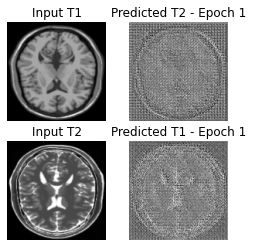

Saving checkpoint for epoch 1 at ./training_checkpoints/ckpt-1


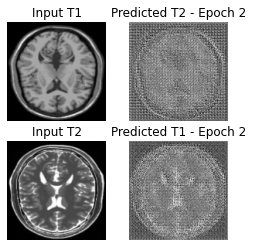

Saving checkpoint for epoch 2 at ./training_checkpoints/ckpt-2


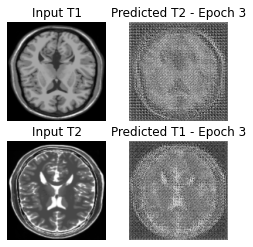

Saving checkpoint for epoch 3 at ./training_checkpoints/ckpt-3


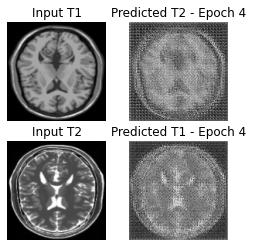

Saving checkpoint for epoch 4 at ./training_checkpoints/ckpt-4


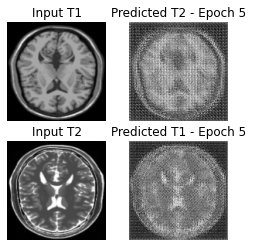

Saving checkpoint for epoch 5 at ./training_checkpoints/ckpt-5


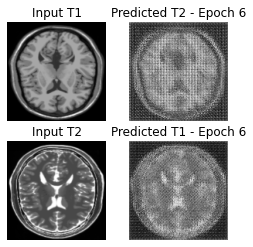

Saving checkpoint for epoch 6 at ./training_checkpoints/ckpt-6


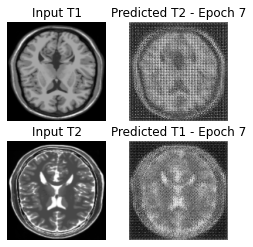

Saving checkpoint for epoch 7 at ./training_checkpoints/ckpt-7


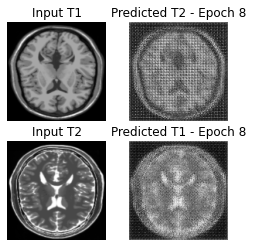

Saving checkpoint for epoch 8 at ./training_checkpoints/ckpt-8


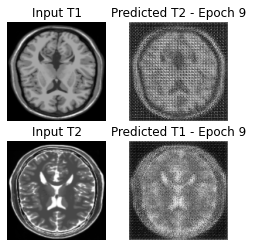

Saving checkpoint for epoch 9 at ./training_checkpoints/ckpt-9


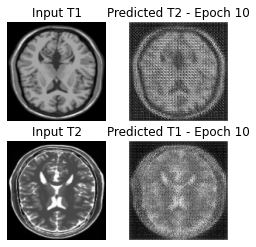

Saving checkpoint for epoch 10 at ./training_checkpoints/ckpt-10


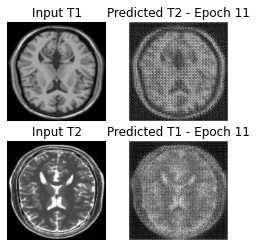

Saving checkpoint for epoch 11 at ./training_checkpoints/ckpt-11


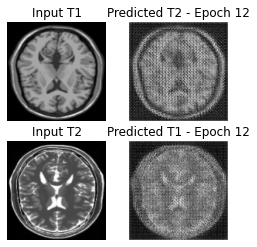

Saving checkpoint for epoch 12 at ./training_checkpoints/ckpt-12


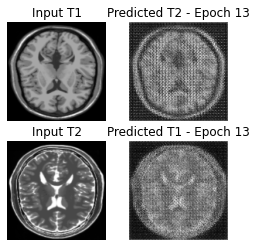

Saving checkpoint for epoch 13 at ./training_checkpoints/ckpt-13


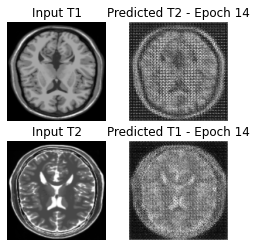

Saving checkpoint for epoch 14 at ./training_checkpoints/ckpt-14


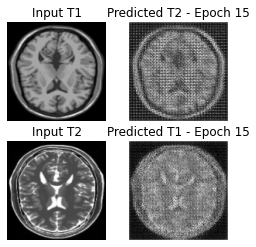

Saving checkpoint for epoch 15 at ./training_checkpoints/ckpt-15


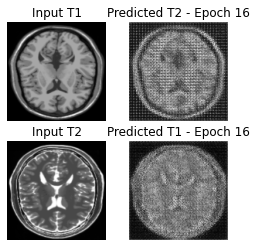

Saving checkpoint for epoch 16 at ./training_checkpoints/ckpt-16


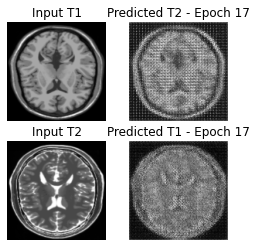

Saving checkpoint for epoch 17 at ./training_checkpoints/ckpt-17


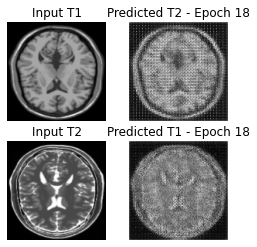

Saving checkpoint for epoch 18 at ./training_checkpoints/ckpt-18


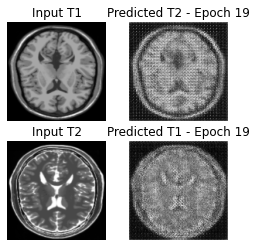

Saving checkpoint for epoch 19 at ./training_checkpoints/ckpt-19


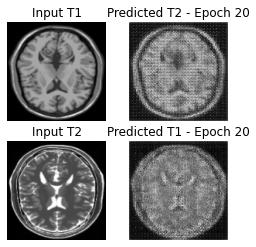

Saving checkpoint for epoch 20 at ./training_checkpoints/ckpt-20


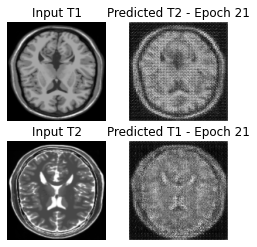

Saving checkpoint for epoch 21 at ./training_checkpoints/ckpt-21


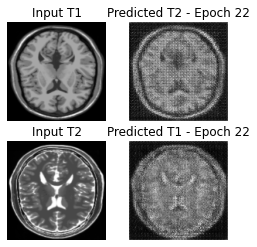

Saving checkpoint for epoch 22 at ./training_checkpoints/ckpt-22


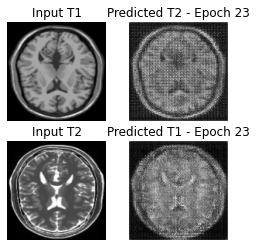

Saving checkpoint for epoch 23 at ./training_checkpoints/ckpt-23


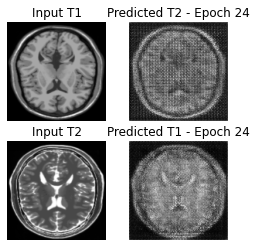

Saving checkpoint for epoch 24 at ./training_checkpoints/ckpt-24


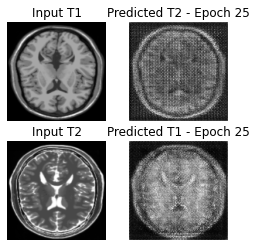

Saving checkpoint for epoch 25 at ./training_checkpoints/ckpt-25


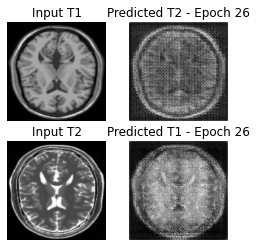

Saving checkpoint for epoch 26 at ./training_checkpoints/ckpt-26


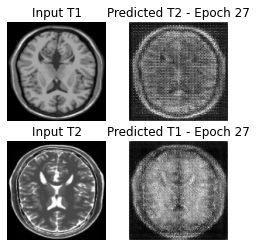

Saving checkpoint for epoch 27 at ./training_checkpoints/ckpt-27


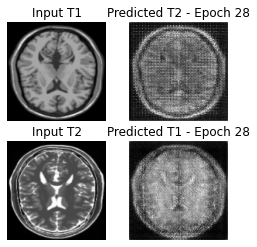

Saving checkpoint for epoch 28 at ./training_checkpoints/ckpt-28


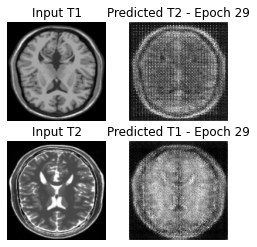

Saving checkpoint for epoch 29 at ./training_checkpoints/ckpt-29


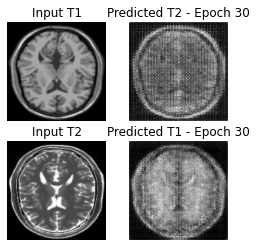

Saving checkpoint for epoch 30 at ./training_checkpoints/ckpt-30


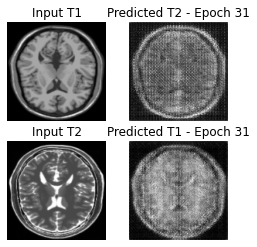

Saving checkpoint for epoch 31 at ./training_checkpoints/ckpt-31


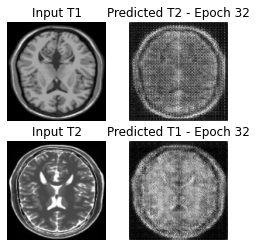

Saving checkpoint for epoch 32 at ./training_checkpoints/ckpt-32


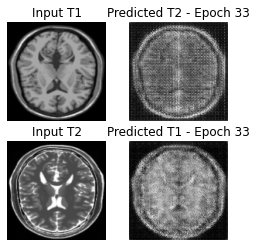

Saving checkpoint for epoch 33 at ./training_checkpoints/ckpt-33


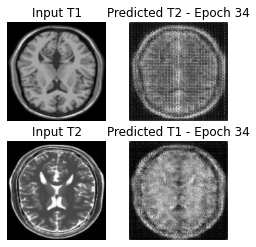

Saving checkpoint for epoch 34 at ./training_checkpoints/ckpt-34


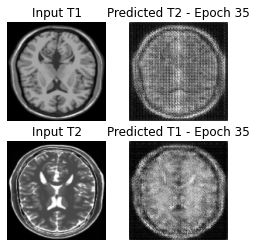

Saving checkpoint for epoch 35 at ./training_checkpoints/ckpt-35


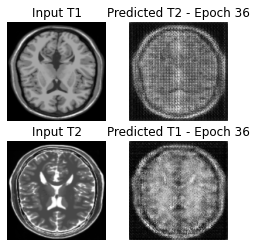

Saving checkpoint for epoch 36 at ./training_checkpoints/ckpt-36


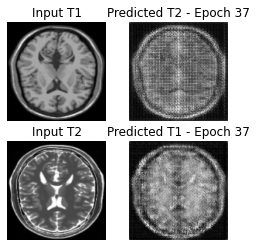

Saving checkpoint for epoch 37 at ./training_checkpoints/ckpt-37


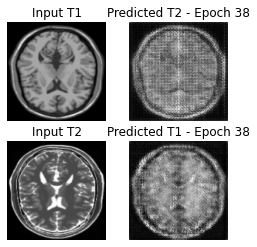

Saving checkpoint for epoch 38 at ./training_checkpoints/ckpt-38


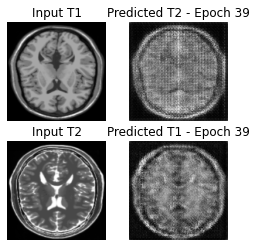

Saving checkpoint for epoch 39 at ./training_checkpoints/ckpt-39


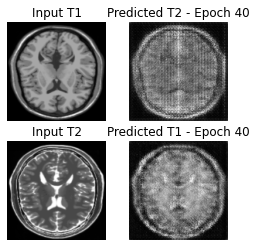

Saving checkpoint for epoch 40 at ./training_checkpoints/ckpt-40


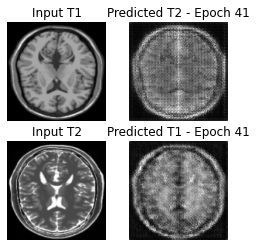

Saving checkpoint for epoch 41 at ./training_checkpoints/ckpt-41


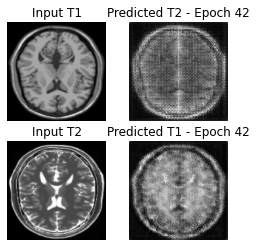

Saving checkpoint for epoch 42 at ./training_checkpoints/ckpt-42


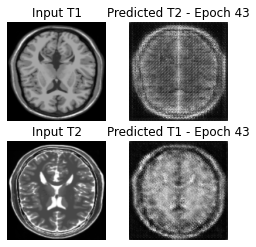

Saving checkpoint for epoch 43 at ./training_checkpoints/ckpt-43


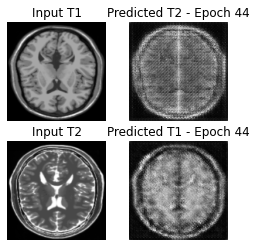

Saving checkpoint for epoch 44 at ./training_checkpoints/ckpt-44


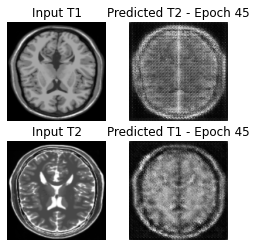

Saving checkpoint for epoch 45 at ./training_checkpoints/ckpt-45


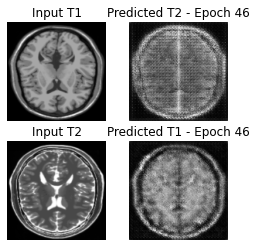

Saving checkpoint for epoch 46 at ./training_checkpoints/ckpt-46


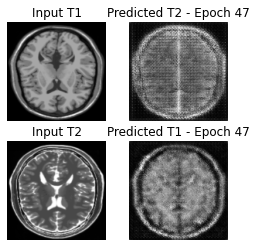

Saving checkpoint for epoch 47 at ./training_checkpoints/ckpt-47


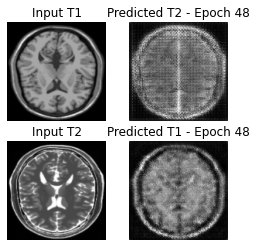

Saving checkpoint for epoch 48 at ./training_checkpoints/ckpt-48


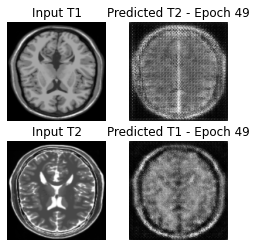

Saving checkpoint for epoch 49 at ./training_checkpoints/ckpt-49


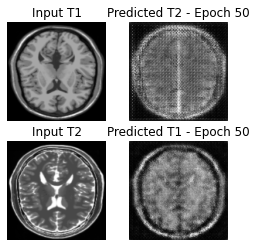

Saving checkpoint for epoch 50 at ./training_checkpoints/ckpt-50


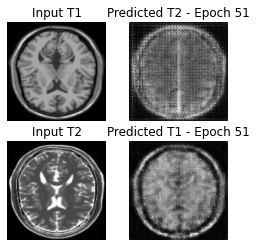

Saving checkpoint for epoch 51 at ./training_checkpoints/ckpt-51


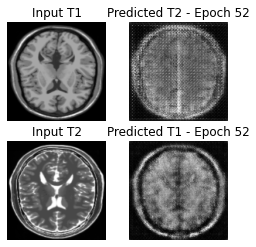

Saving checkpoint for epoch 52 at ./training_checkpoints/ckpt-52


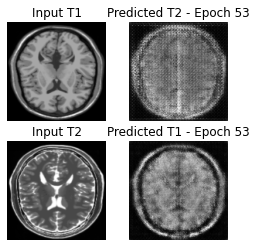

Saving checkpoint for epoch 53 at ./training_checkpoints/ckpt-53


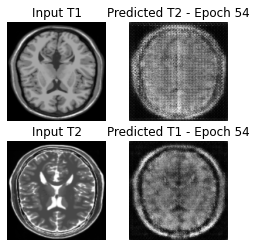

Saving checkpoint for epoch 54 at ./training_checkpoints/ckpt-54


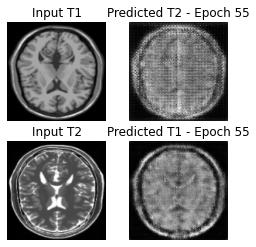

Saving checkpoint for epoch 55 at ./training_checkpoints/ckpt-55


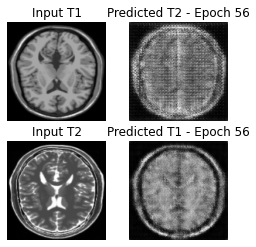

Saving checkpoint for epoch 56 at ./training_checkpoints/ckpt-56


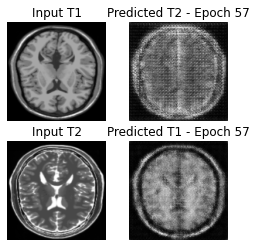

Saving checkpoint for epoch 57 at ./training_checkpoints/ckpt-57


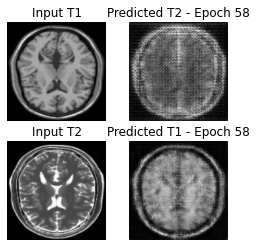

Saving checkpoint for epoch 58 at ./training_checkpoints/ckpt-58


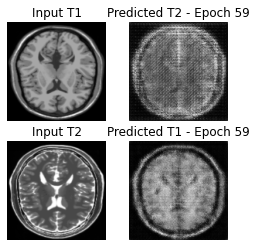

Saving checkpoint for epoch 59 at ./training_checkpoints/ckpt-59


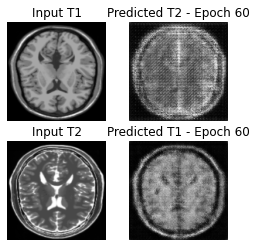

Saving checkpoint for epoch 60 at ./training_checkpoints/ckpt-60


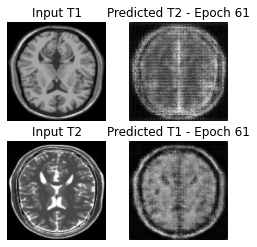

Saving checkpoint for epoch 61 at ./training_checkpoints/ckpt-61


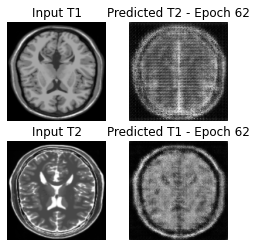

Saving checkpoint for epoch 62 at ./training_checkpoints/ckpt-62


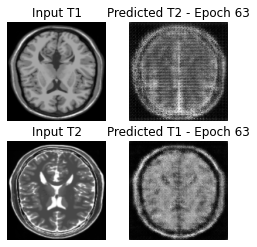

Saving checkpoint for epoch 63 at ./training_checkpoints/ckpt-63


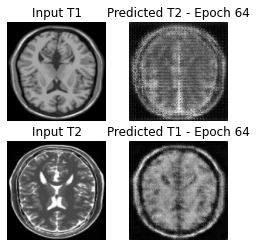

Saving checkpoint for epoch 64 at ./training_checkpoints/ckpt-64


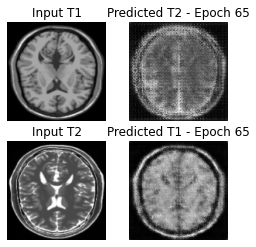

Saving checkpoint for epoch 65 at ./training_checkpoints/ckpt-65


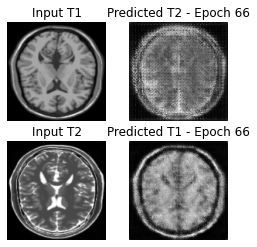

Saving checkpoint for epoch 66 at ./training_checkpoints/ckpt-66


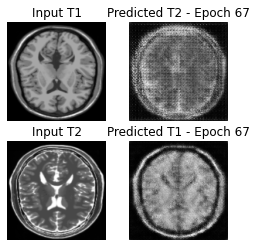

Saving checkpoint for epoch 67 at ./training_checkpoints/ckpt-67


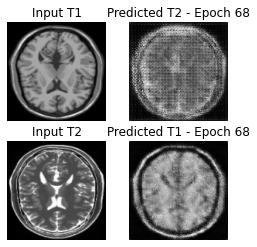

Saving checkpoint for epoch 68 at ./training_checkpoints/ckpt-68


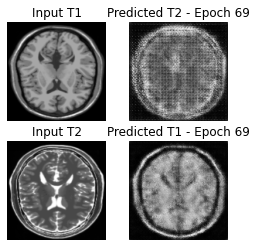

Saving checkpoint for epoch 69 at ./training_checkpoints/ckpt-69


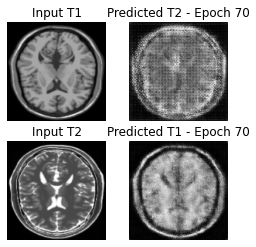

Saving checkpoint for epoch 70 at ./training_checkpoints/ckpt-70


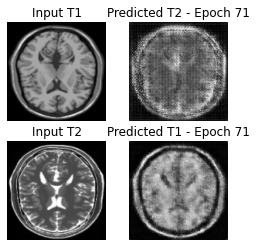

Saving checkpoint for epoch 71 at ./training_checkpoints/ckpt-71


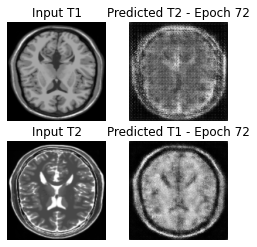

Saving checkpoint for epoch 72 at ./training_checkpoints/ckpt-72


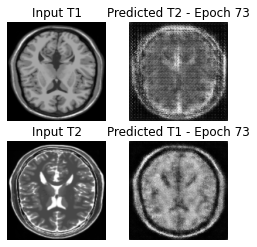

Saving checkpoint for epoch 73 at ./training_checkpoints/ckpt-73


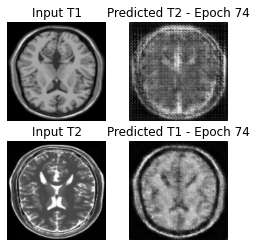

Saving checkpoint for epoch 74 at ./training_checkpoints/ckpt-74


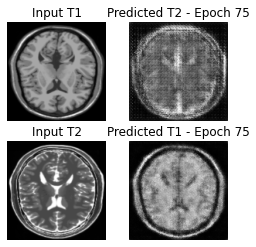

Saving checkpoint for epoch 75 at ./training_checkpoints/ckpt-75


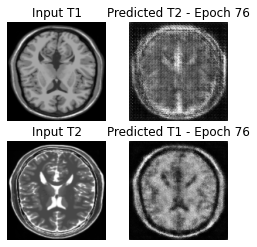

Saving checkpoint for epoch 76 at ./training_checkpoints/ckpt-76


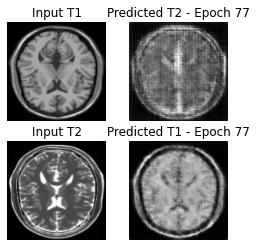

Saving checkpoint for epoch 77 at ./training_checkpoints/ckpt-77


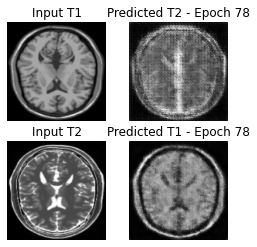

Saving checkpoint for epoch 78 at ./training_checkpoints/ckpt-78


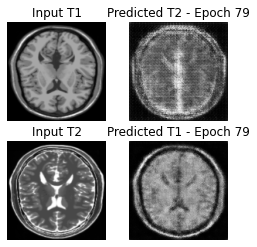

Saving checkpoint for epoch 79 at ./training_checkpoints/ckpt-79


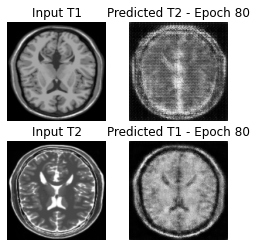

Saving checkpoint for epoch 80 at ./training_checkpoints/ckpt-80


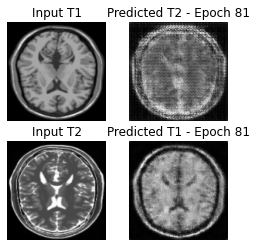

Saving checkpoint for epoch 81 at ./training_checkpoints/ckpt-81


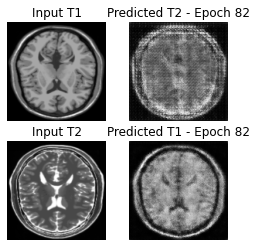

Saving checkpoint for epoch 82 at ./training_checkpoints/ckpt-82


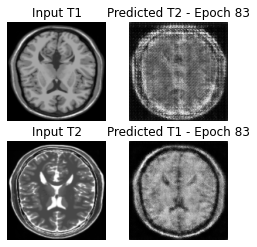

Saving checkpoint for epoch 83 at ./training_checkpoints/ckpt-83


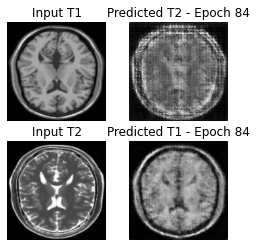

Saving checkpoint for epoch 84 at ./training_checkpoints/ckpt-84


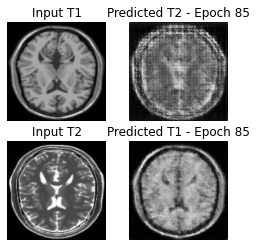

Saving checkpoint for epoch 85 at ./training_checkpoints/ckpt-85


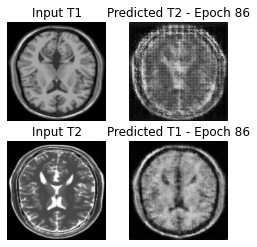

Saving checkpoint for epoch 86 at ./training_checkpoints/ckpt-86


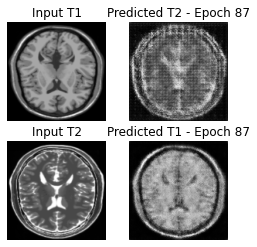

Saving checkpoint for epoch 87 at ./training_checkpoints/ckpt-87


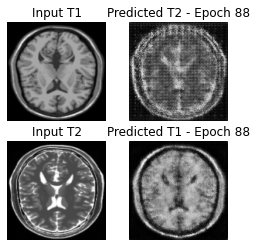

Saving checkpoint for epoch 88 at ./training_checkpoints/ckpt-88


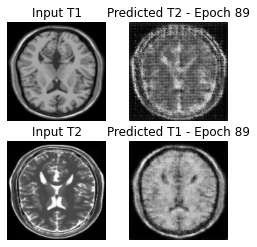

Saving checkpoint for epoch 89 at ./training_checkpoints/ckpt-89


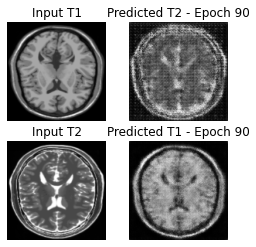

Saving checkpoint for epoch 90 at ./training_checkpoints/ckpt-90


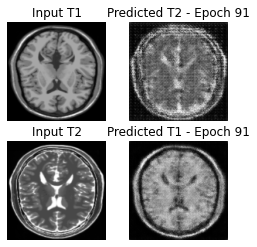

Saving checkpoint for epoch 91 at ./training_checkpoints/ckpt-91


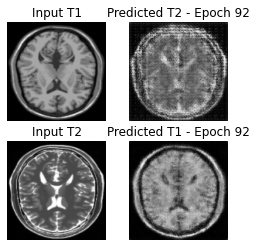

Saving checkpoint for epoch 92 at ./training_checkpoints/ckpt-92


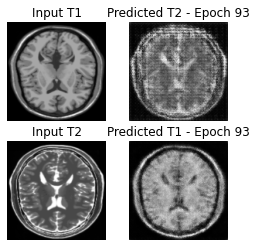

Saving checkpoint for epoch 93 at ./training_checkpoints/ckpt-93


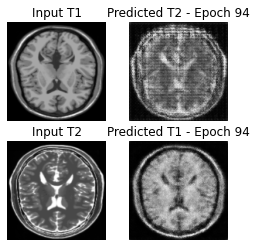

Saving checkpoint for epoch 94 at ./training_checkpoints/ckpt-94


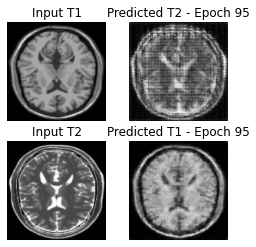

Saving checkpoint for epoch 95 at ./training_checkpoints/ckpt-95


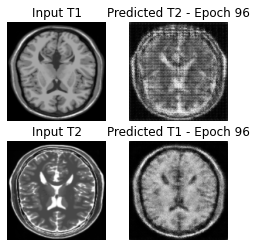

Saving checkpoint for epoch 96 at ./training_checkpoints/ckpt-96


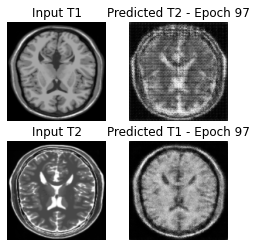

Saving checkpoint for epoch 97 at ./training_checkpoints/ckpt-97


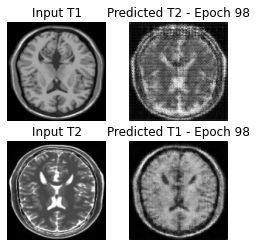

Saving checkpoint for epoch 98 at ./training_checkpoints/ckpt-98


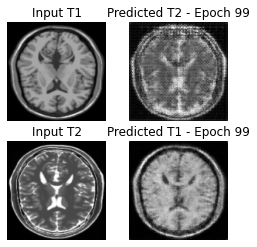

Saving checkpoint for epoch 99 at ./training_checkpoints/ckpt-99


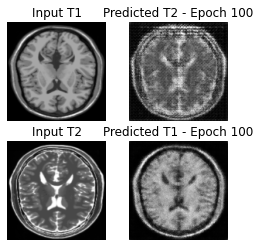

Saving checkpoint for epoch 100 at ./training_checkpoints/ckpt-100


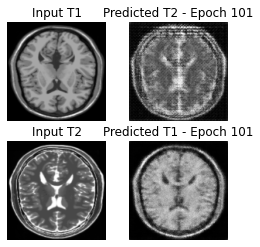

Saving checkpoint for epoch 101 at ./training_checkpoints/ckpt-101


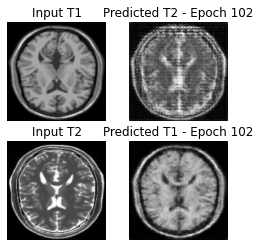

Saving checkpoint for epoch 102 at ./training_checkpoints/ckpt-102


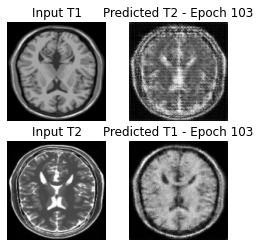

Saving checkpoint for epoch 103 at ./training_checkpoints/ckpt-103


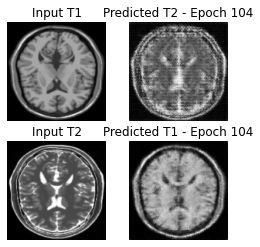

Saving checkpoint for epoch 104 at ./training_checkpoints/ckpt-104


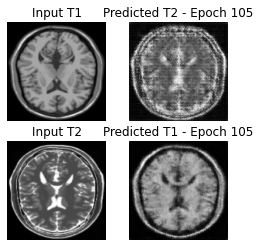

Saving checkpoint for epoch 105 at ./training_checkpoints/ckpt-105


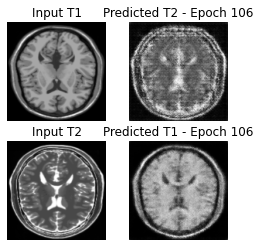

Saving checkpoint for epoch 106 at ./training_checkpoints/ckpt-106


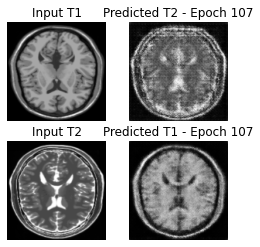

Saving checkpoint for epoch 107 at ./training_checkpoints/ckpt-107


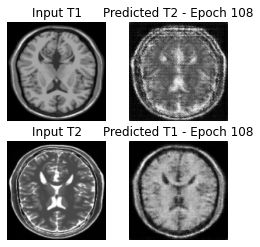

Saving checkpoint for epoch 108 at ./training_checkpoints/ckpt-108


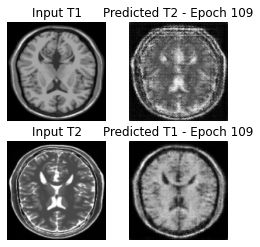

Saving checkpoint for epoch 109 at ./training_checkpoints/ckpt-109


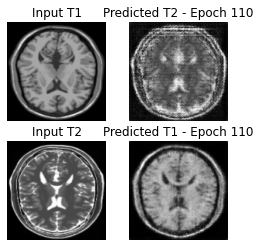

Saving checkpoint for epoch 110 at ./training_checkpoints/ckpt-110


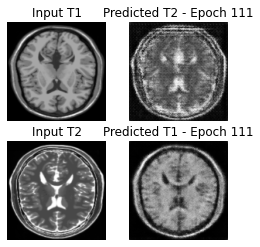

Saving checkpoint for epoch 111 at ./training_checkpoints/ckpt-111


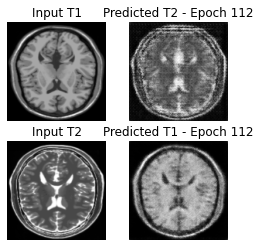

Saving checkpoint for epoch 112 at ./training_checkpoints/ckpt-112


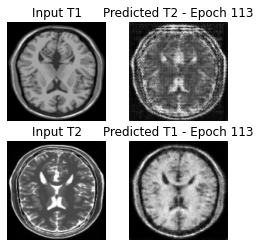

Saving checkpoint for epoch 113 at ./training_checkpoints/ckpt-113


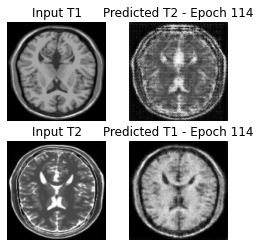

Saving checkpoint for epoch 114 at ./training_checkpoints/ckpt-114


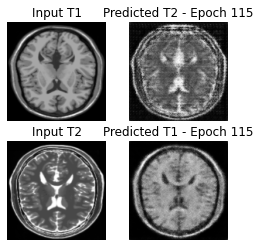

Saving checkpoint for epoch 115 at ./training_checkpoints/ckpt-115


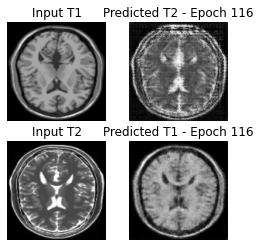

Saving checkpoint for epoch 116 at ./training_checkpoints/ckpt-116


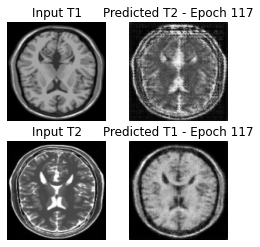

Saving checkpoint for epoch 117 at ./training_checkpoints/ckpt-117


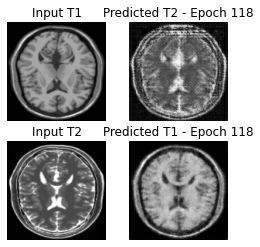

Saving checkpoint for epoch 118 at ./training_checkpoints/ckpt-118


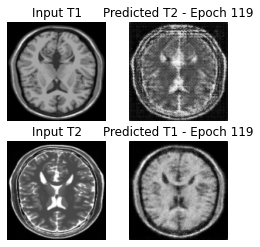

Saving checkpoint for epoch 119 at ./training_checkpoints/ckpt-119


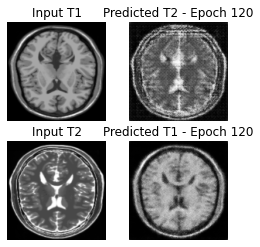

Saving checkpoint for epoch 120 at ./training_checkpoints/ckpt-120


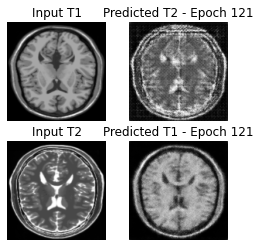

Saving checkpoint for epoch 121 at ./training_checkpoints/ckpt-121


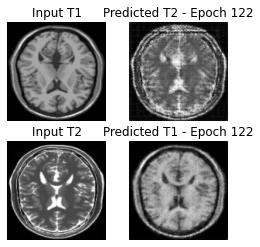

Saving checkpoint for epoch 122 at ./training_checkpoints/ckpt-122


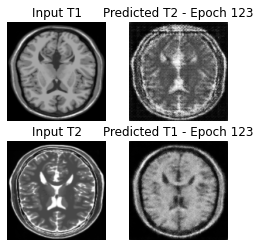

Saving checkpoint for epoch 123 at ./training_checkpoints/ckpt-123


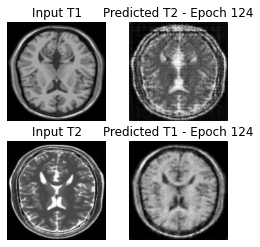

Saving checkpoint for epoch 124 at ./training_checkpoints/ckpt-124


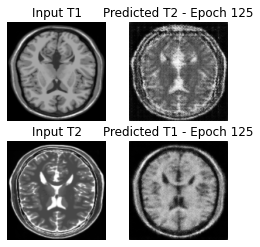

Saving checkpoint for epoch 125 at ./training_checkpoints/ckpt-125


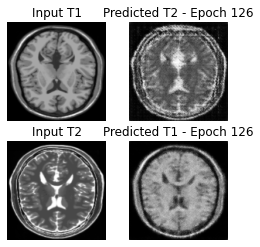

Saving checkpoint for epoch 126 at ./training_checkpoints/ckpt-126


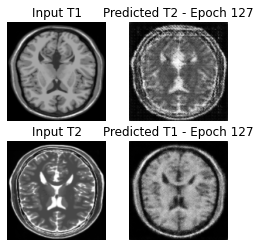

Saving checkpoint for epoch 127 at ./training_checkpoints/ckpt-127


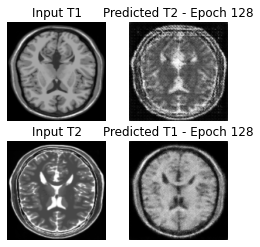

Saving checkpoint for epoch 128 at ./training_checkpoints/ckpt-128


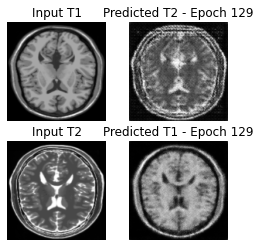

Saving checkpoint for epoch 129 at ./training_checkpoints/ckpt-129


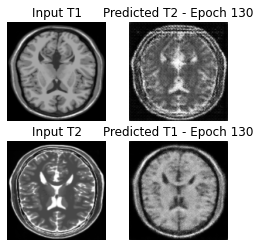

Saving checkpoint for epoch 130 at ./training_checkpoints/ckpt-130


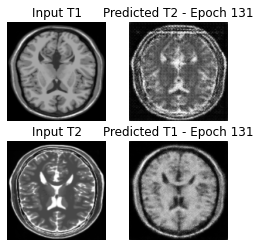

Saving checkpoint for epoch 131 at ./training_checkpoints/ckpt-131


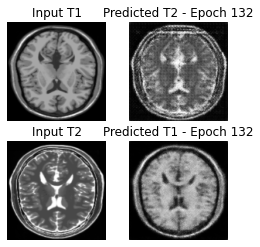

Saving checkpoint for epoch 132 at ./training_checkpoints/ckpt-132


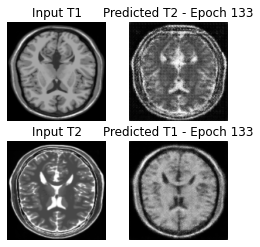

Saving checkpoint for epoch 133 at ./training_checkpoints/ckpt-133


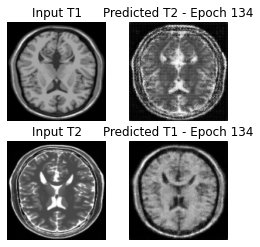

Saving checkpoint for epoch 134 at ./training_checkpoints/ckpt-134


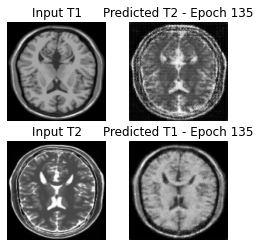

Saving checkpoint for epoch 135 at ./training_checkpoints/ckpt-135


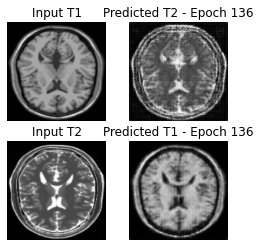

Saving checkpoint for epoch 136 at ./training_checkpoints/ckpt-136


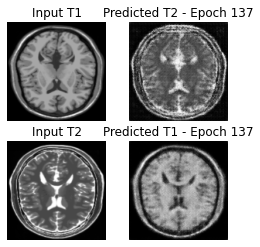

Saving checkpoint for epoch 137 at ./training_checkpoints/ckpt-137


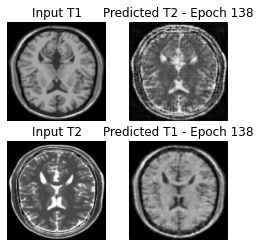

Saving checkpoint for epoch 138 at ./training_checkpoints/ckpt-138


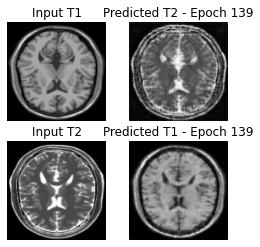

Saving checkpoint for epoch 139 at ./training_checkpoints/ckpt-139


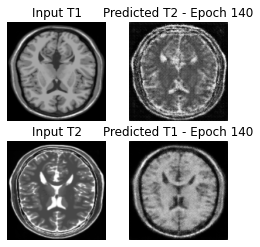

Saving checkpoint for epoch 140 at ./training_checkpoints/ckpt-140


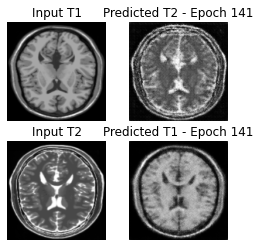

Saving checkpoint for epoch 141 at ./training_checkpoints/ckpt-141


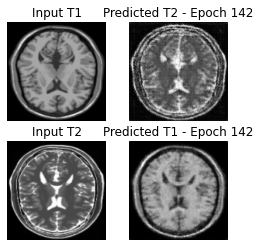

Saving checkpoint for epoch 142 at ./training_checkpoints/ckpt-142


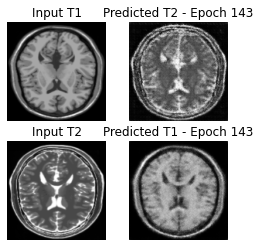

Saving checkpoint for epoch 143 at ./training_checkpoints/ckpt-143


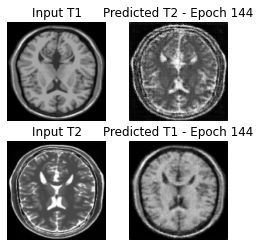

Saving checkpoint for epoch 144 at ./training_checkpoints/ckpt-144


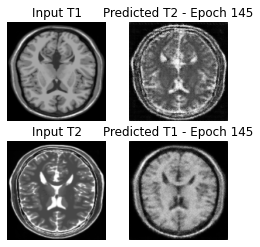

Saving checkpoint for epoch 145 at ./training_checkpoints/ckpt-145


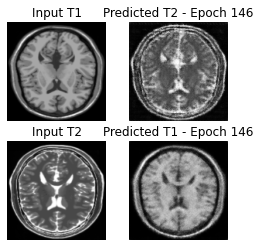

Saving checkpoint for epoch 146 at ./training_checkpoints/ckpt-146


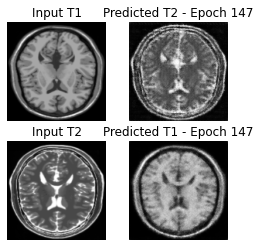

Saving checkpoint for epoch 147 at ./training_checkpoints/ckpt-147


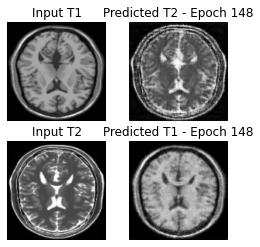

Saving checkpoint for epoch 148 at ./training_checkpoints/ckpt-148


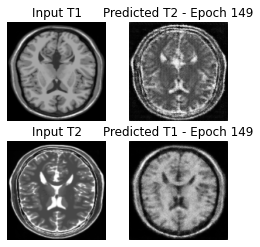

Saving checkpoint for epoch 149 at ./training_checkpoints/ckpt-149


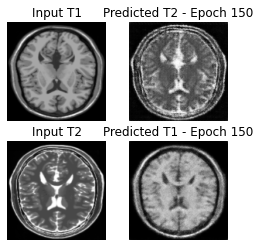

Saving checkpoint for epoch 150 at ./training_checkpoints/ckpt-150


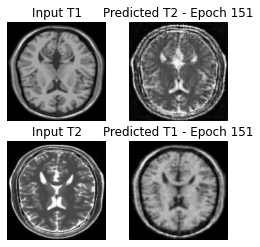

Saving checkpoint for epoch 151 at ./training_checkpoints/ckpt-151


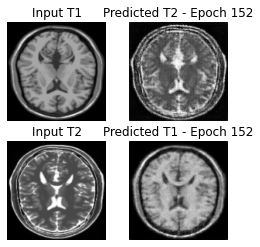

Saving checkpoint for epoch 152 at ./training_checkpoints/ckpt-152


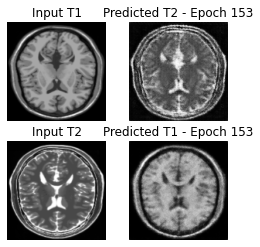

Saving checkpoint for epoch 153 at ./training_checkpoints/ckpt-153


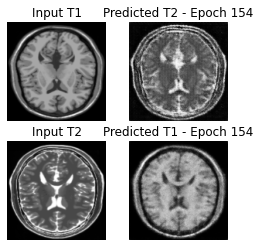

Saving checkpoint for epoch 154 at ./training_checkpoints/ckpt-154


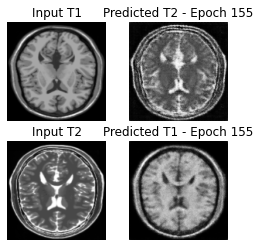

Saving checkpoint for epoch 155 at ./training_checkpoints/ckpt-155


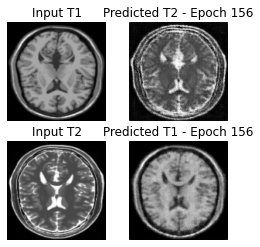

Saving checkpoint for epoch 156 at ./training_checkpoints/ckpt-156


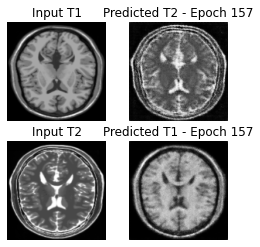

Saving checkpoint for epoch 157 at ./training_checkpoints/ckpt-157


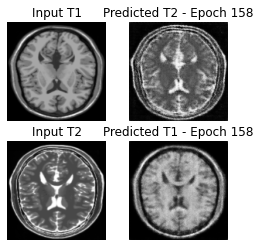

Saving checkpoint for epoch 158 at ./training_checkpoints/ckpt-158


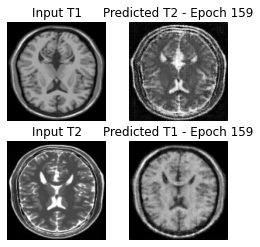

Saving checkpoint for epoch 159 at ./training_checkpoints/ckpt-159


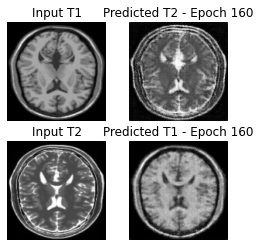

Saving checkpoint for epoch 160 at ./training_checkpoints/ckpt-160


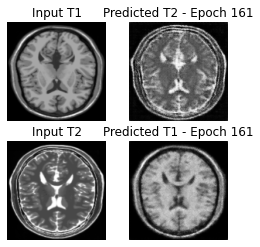

Saving checkpoint for epoch 161 at ./training_checkpoints/ckpt-161


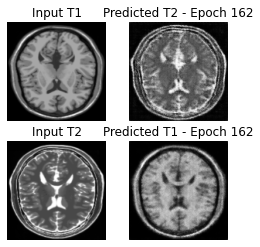

Saving checkpoint for epoch 162 at ./training_checkpoints/ckpt-162


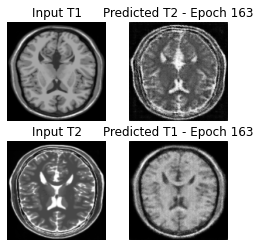

Saving checkpoint for epoch 163 at ./training_checkpoints/ckpt-163


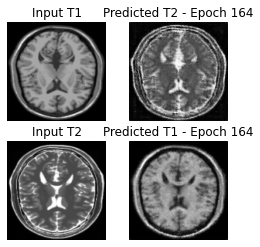

Saving checkpoint for epoch 164 at ./training_checkpoints/ckpt-164


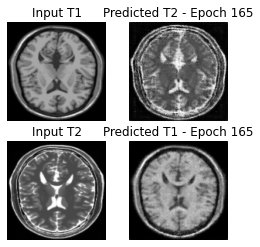

Saving checkpoint for epoch 165 at ./training_checkpoints/ckpt-165


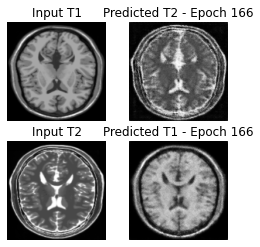

Saving checkpoint for epoch 166 at ./training_checkpoints/ckpt-166


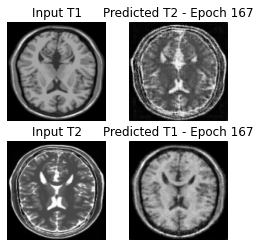

Saving checkpoint for epoch 167 at ./training_checkpoints/ckpt-167


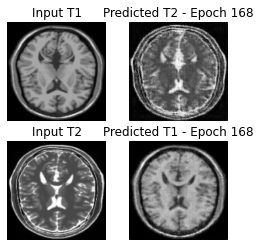

Saving checkpoint for epoch 168 at ./training_checkpoints/ckpt-168


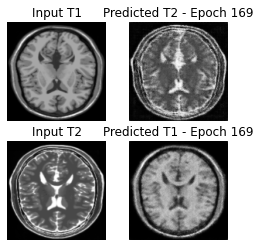

Saving checkpoint for epoch 169 at ./training_checkpoints/ckpt-169


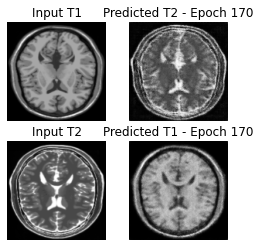

Saving checkpoint for epoch 170 at ./training_checkpoints/ckpt-170


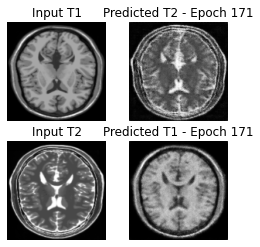

Saving checkpoint for epoch 171 at ./training_checkpoints/ckpt-171


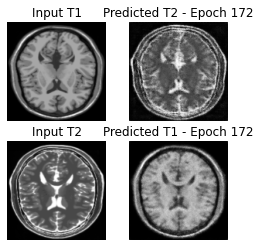

Saving checkpoint for epoch 172 at ./training_checkpoints/ckpt-172


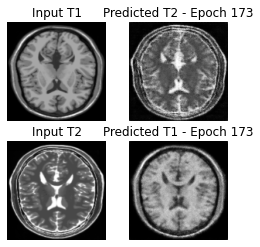

Saving checkpoint for epoch 173 at ./training_checkpoints/ckpt-173


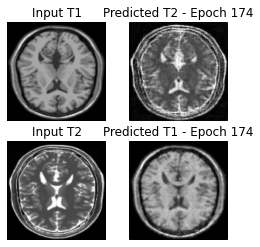

Saving checkpoint for epoch 174 at ./training_checkpoints/ckpt-174


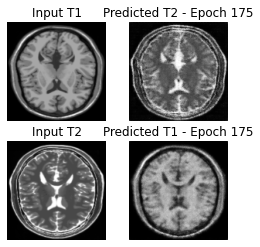

Saving checkpoint for epoch 175 at ./training_checkpoints/ckpt-175


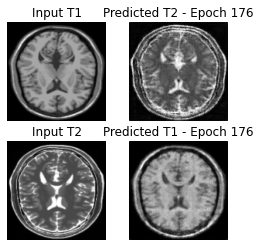

Saving checkpoint for epoch 176 at ./training_checkpoints/ckpt-176


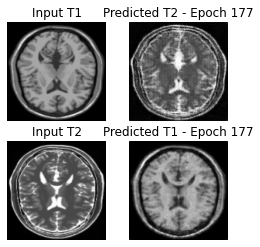

Saving checkpoint for epoch 177 at ./training_checkpoints/ckpt-177


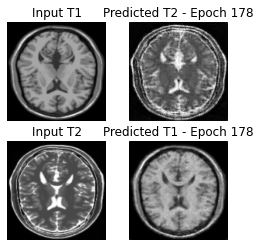

Saving checkpoint for epoch 178 at ./training_checkpoints/ckpt-178


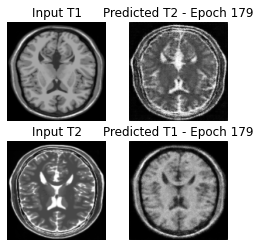

Saving checkpoint for epoch 179 at ./training_checkpoints/ckpt-179


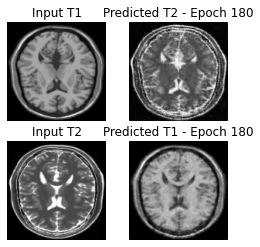

Saving checkpoint for epoch 180 at ./training_checkpoints/ckpt-180


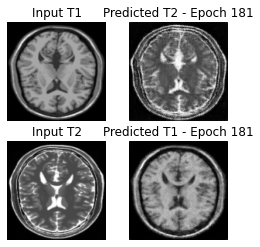

Saving checkpoint for epoch 181 at ./training_checkpoints/ckpt-181


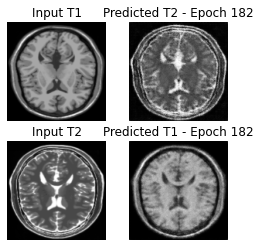

Saving checkpoint for epoch 182 at ./training_checkpoints/ckpt-182


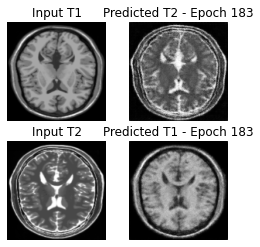

Saving checkpoint for epoch 183 at ./training_checkpoints/ckpt-183


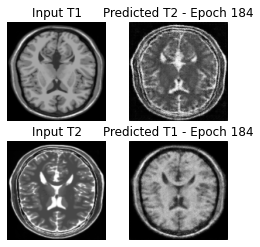

Saving checkpoint for epoch 184 at ./training_checkpoints/ckpt-184


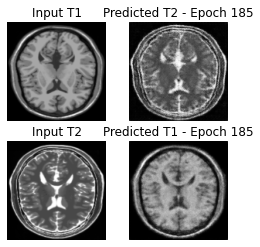

Saving checkpoint for epoch 185 at ./training_checkpoints/ckpt-185


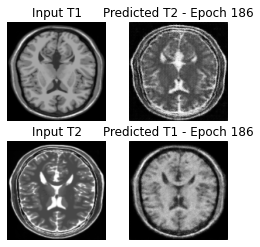

Saving checkpoint for epoch 186 at ./training_checkpoints/ckpt-186


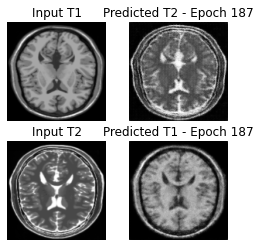

Saving checkpoint for epoch 187 at ./training_checkpoints/ckpt-187


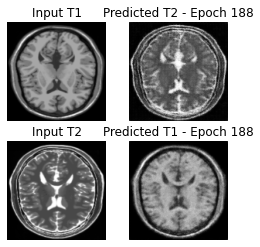

Saving checkpoint for epoch 188 at ./training_checkpoints/ckpt-188


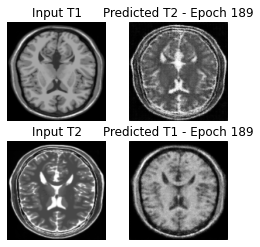

Saving checkpoint for epoch 189 at ./training_checkpoints/ckpt-189


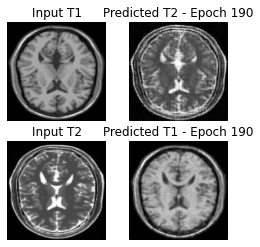

Saving checkpoint for epoch 190 at ./training_checkpoints/ckpt-190


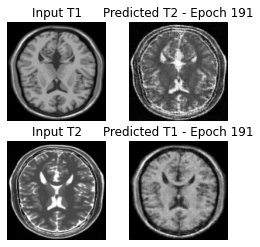

Saving checkpoint for epoch 191 at ./training_checkpoints/ckpt-191


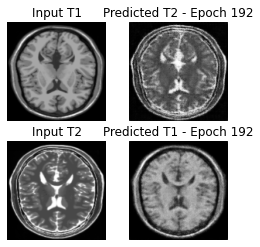

Saving checkpoint for epoch 192 at ./training_checkpoints/ckpt-192


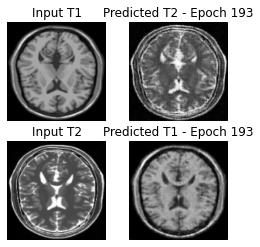

Saving checkpoint for epoch 193 at ./training_checkpoints/ckpt-193


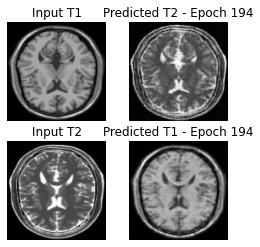

Saving checkpoint for epoch 194 at ./training_checkpoints/ckpt-194


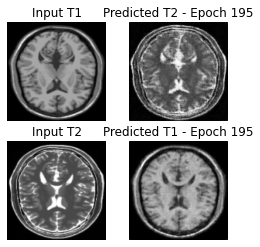

Saving checkpoint for epoch 195 at ./training_checkpoints/ckpt-195


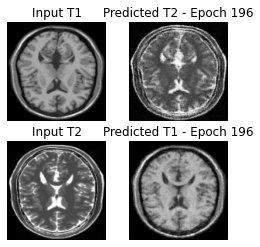

Saving checkpoint for epoch 196 at ./training_checkpoints/ckpt-196


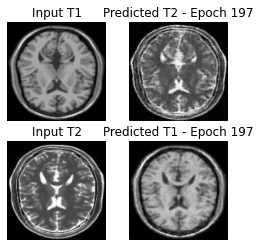

Saving checkpoint for epoch 197 at ./training_checkpoints/ckpt-197


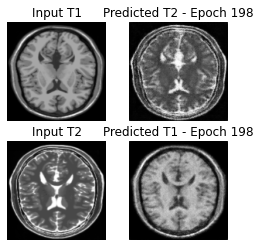

Saving checkpoint for epoch 198 at ./training_checkpoints/ckpt-198


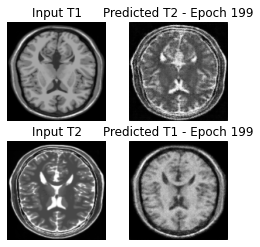

Saving checkpoint for epoch 199 at ./training_checkpoints/ckpt-199


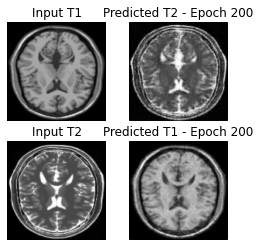

Saving checkpoint for epoch 200 at ./training_checkpoints/ckpt-200


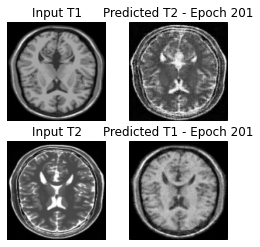

Saving checkpoint for epoch 201 at ./training_checkpoints/ckpt-201


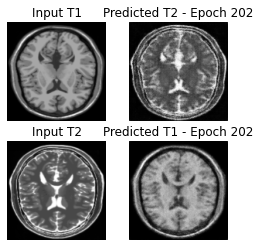

Saving checkpoint for epoch 202 at ./training_checkpoints/ckpt-202


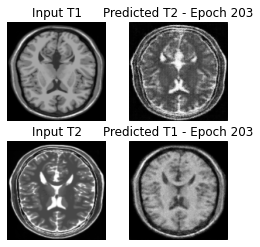

Saving checkpoint for epoch 203 at ./training_checkpoints/ckpt-203


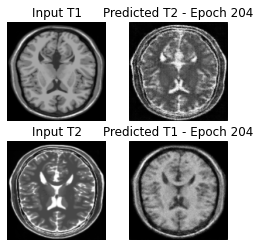

Saving checkpoint for epoch 204 at ./training_checkpoints/ckpt-204


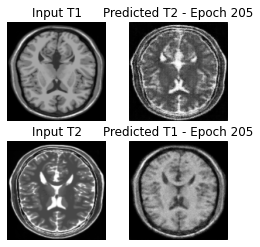

Saving checkpoint for epoch 205 at ./training_checkpoints/ckpt-205


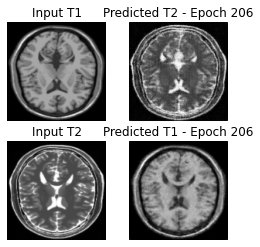

Saving checkpoint for epoch 206 at ./training_checkpoints/ckpt-206


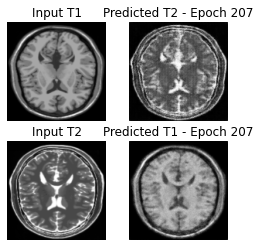

Saving checkpoint for epoch 207 at ./training_checkpoints/ckpt-207


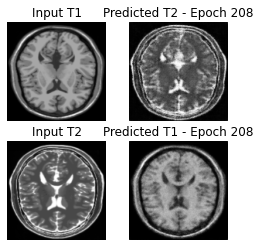

Saving checkpoint for epoch 208 at ./training_checkpoints/ckpt-208


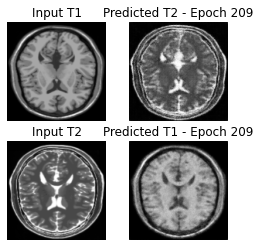

Saving checkpoint for epoch 209 at ./training_checkpoints/ckpt-209


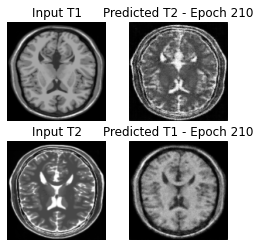

Saving checkpoint for epoch 210 at ./training_checkpoints/ckpt-210


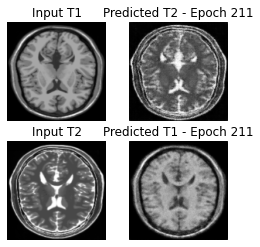

Saving checkpoint for epoch 211 at ./training_checkpoints/ckpt-211


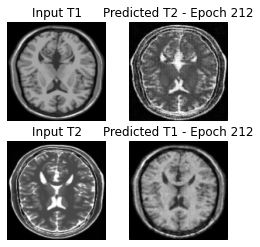

Saving checkpoint for epoch 212 at ./training_checkpoints/ckpt-212


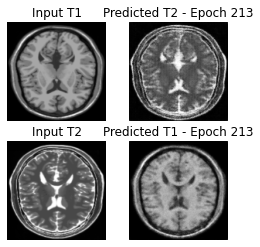

Saving checkpoint for epoch 213 at ./training_checkpoints/ckpt-213


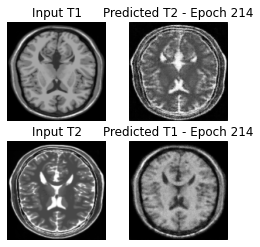

Saving checkpoint for epoch 214 at ./training_checkpoints/ckpt-214


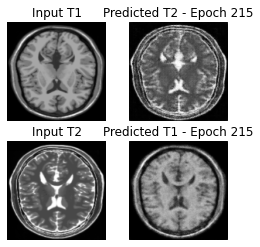

Saving checkpoint for epoch 215 at ./training_checkpoints/ckpt-215


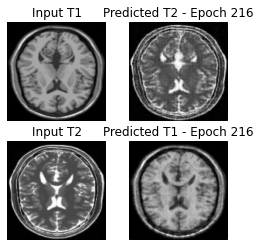

Saving checkpoint for epoch 216 at ./training_checkpoints/ckpt-216


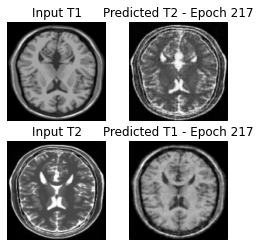

Saving checkpoint for epoch 217 at ./training_checkpoints/ckpt-217


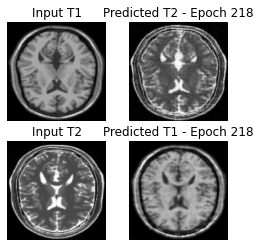

Saving checkpoint for epoch 218 at ./training_checkpoints/ckpt-218


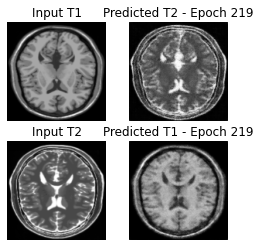

Saving checkpoint for epoch 219 at ./training_checkpoints/ckpt-219


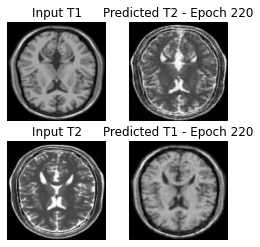

Saving checkpoint for epoch 220 at ./training_checkpoints/ckpt-220


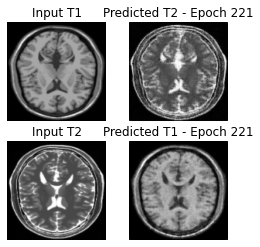

Saving checkpoint for epoch 221 at ./training_checkpoints/ckpt-221


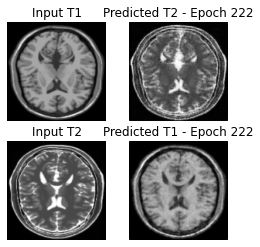

Saving checkpoint for epoch 222 at ./training_checkpoints/ckpt-222


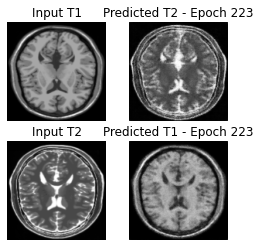

Saving checkpoint for epoch 223 at ./training_checkpoints/ckpt-223


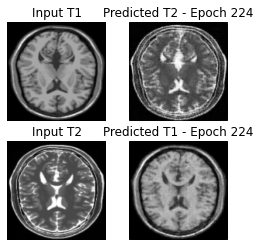

Saving checkpoint for epoch 224 at ./training_checkpoints/ckpt-224


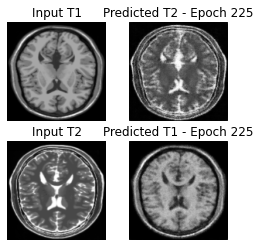

Saving checkpoint for epoch 225 at ./training_checkpoints/ckpt-225


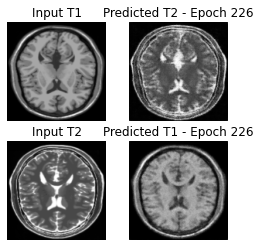

Saving checkpoint for epoch 226 at ./training_checkpoints/ckpt-226


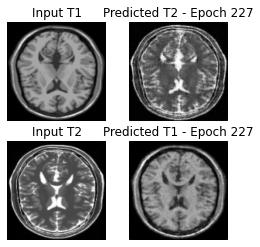

Saving checkpoint for epoch 227 at ./training_checkpoints/ckpt-227


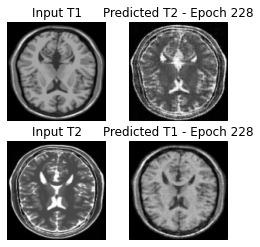

Saving checkpoint for epoch 228 at ./training_checkpoints/ckpt-228


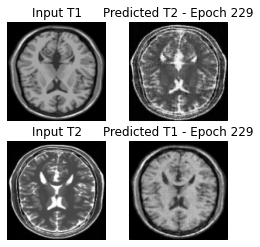

Saving checkpoint for epoch 229 at ./training_checkpoints/ckpt-229


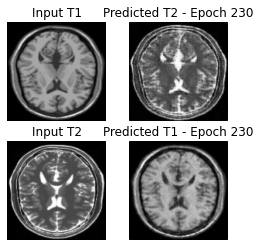

Saving checkpoint for epoch 230 at ./training_checkpoints/ckpt-230


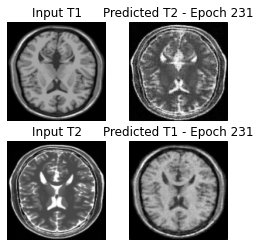

Saving checkpoint for epoch 231 at ./training_checkpoints/ckpt-231


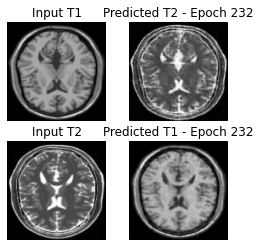

Saving checkpoint for epoch 232 at ./training_checkpoints/ckpt-232


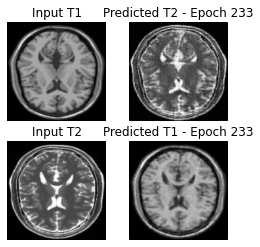

Saving checkpoint for epoch 233 at ./training_checkpoints/ckpt-233


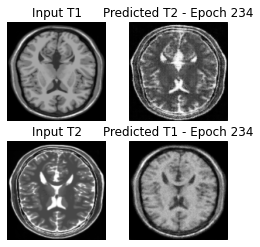

Saving checkpoint for epoch 234 at ./training_checkpoints/ckpt-234


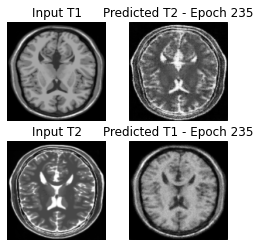

Saving checkpoint for epoch 235 at ./training_checkpoints/ckpt-235


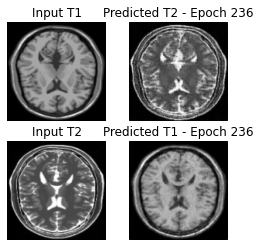

Saving checkpoint for epoch 236 at ./training_checkpoints/ckpt-236


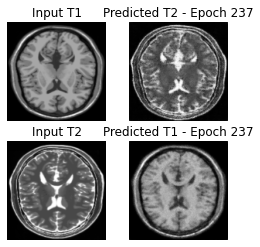

Saving checkpoint for epoch 237 at ./training_checkpoints/ckpt-237


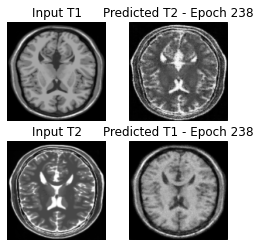

Saving checkpoint for epoch 238 at ./training_checkpoints/ckpt-238


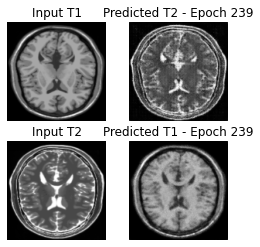

Saving checkpoint for epoch 239 at ./training_checkpoints/ckpt-239


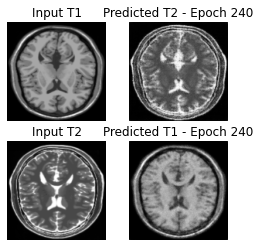

Saving checkpoint for epoch 240 at ./training_checkpoints/ckpt-240


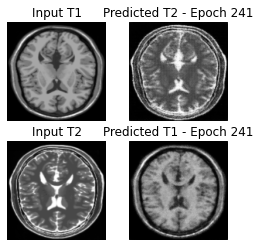

Saving checkpoint for epoch 241 at ./training_checkpoints/ckpt-241


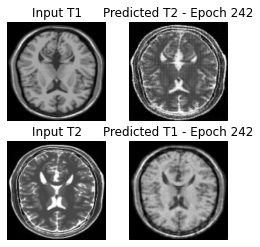

Saving checkpoint for epoch 242 at ./training_checkpoints/ckpt-242


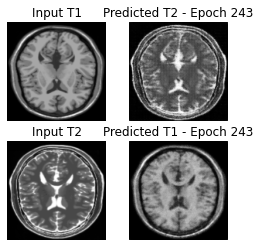

Saving checkpoint for epoch 243 at ./training_checkpoints/ckpt-243


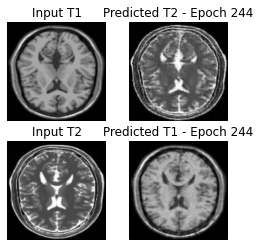

Saving checkpoint for epoch 244 at ./training_checkpoints/ckpt-244


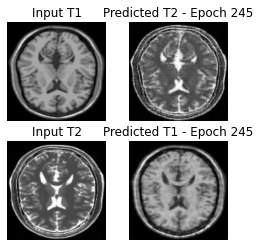

Saving checkpoint for epoch 245 at ./training_checkpoints/ckpt-245


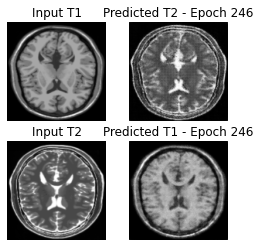

Saving checkpoint for epoch 246 at ./training_checkpoints/ckpt-246


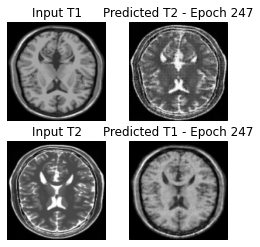

Saving checkpoint for epoch 247 at ./training_checkpoints/ckpt-247


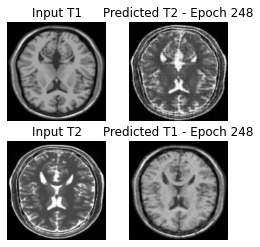

Saving checkpoint for epoch 248 at ./training_checkpoints/ckpt-248


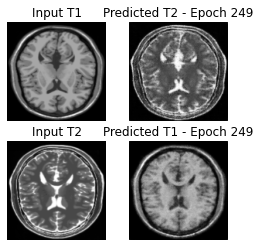

Saving checkpoint for epoch 249 at ./training_checkpoints/ckpt-249


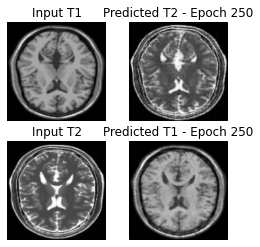

Saving checkpoint for epoch 250 at ./training_checkpoints/ckpt-250


In [ ]:
# Training run - Epochs 1 to 250
for epoch in range(1, EPOCHS+1):
    for image_x in T1_data:
        for image_y in T2_data:
            train_step(image_x, image_y)
    generate_images(generator_T2, sample_T1_data, generator_T1, sample_T2_data, epoch)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)

#### After 250 epochs, the results are good. The predicted images have likeliness to their respective input image in terms of content, while having the style of the other image type. Thus, it comes to conclusion that:

- Predicted T2 has the features of input T1 in the style of T2.
- Predicted T1 has the features of input T2 in the style of T1.

### Generating a GIF for visualization of Results

In [ ]:
anim_file = 'MRI_T1_T2_ver8.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('./generated_images/image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

In [ ]:
!pip install git+https://github.com/tensorflow/docs

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-lf4srkbn
  Running command git clone -q https://github.com/tensorflow/docs /tmp/pip-req-build-lf4srkbn
  Created wheel for tensorflow-docs: filename=tensorflow_docs-0.0.0.dev0-py3-none-any.whl size=179884 sha256=1c046113fbd36ed4ab62b0f4770cae5869ce8e82f23553ecf5a8a64b863244c7
  Stored in directory: /tmp/pip-ephem-wheel-cache-ac7se0fy/wheels/cc/c4/d8/5341e93b6376c5c929c49469fce21155eb69cef1a4da4ce32c
Successfully built tensorflow-docs



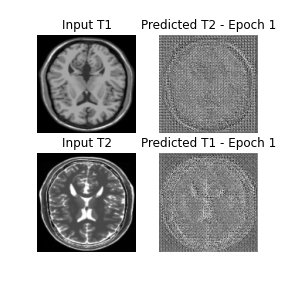

In [ ]:
# Visualizing the progress from epoch to epoch
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

### Conclusion
- We can see that a Cycle GAN architecture is effective in translating the style of T1 weighted MRI images to T2 weighted MRI image inputs, and vice versa.
- This can be very useful in more effective diagnosis, without the need of a second MRI scan. This not only saves time for the doctors, but would also reduce the financial burden on the patients.

#### End of Project